## Update the visualization for easier usage and more functions


In [89]:
from __future__ import print_function
import pandas as pd
import numpy as np
from sompy.sompy import SOMFactory

import sklearn
import sklearn.cluster as cluster
from sklearn import preprocessing
import urllib3
from sklearn.externals import joblib
import glob
import random

import tfprop_sompy
from tfprop_sompy import tfprop_config
from tfprop_sompy import tfprop_vis
from tfprop_sompy import tfprop_analysis
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

import matplotlib as mpl
import matplotlib.pyplot as plt
import images_gen
from images_gen import classify_by_group
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import pickle

In [90]:
from sklearn import model_selection
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.Chem import AllProps
from rdkit.Chem.Draw import IPythonConsole
from rdkit.Chem.Draw import MolDrawing as MolDrawing
from rdkit.Chem.Draw.MolDrawing import DrawingOptions
from IPython.display import SVG
from rdkit.Chem.Draw import SimilarityMaps
from rdkit.Chem import rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D
from rdkit.Chem import AllChem
from rdkit.Chem import AllProps
from rdkit.Chem import Draw
from rdkit.Chem import PandasTools
from rdkit.Chem import Descriptors
from rdkit.Chem import Descriptors3D
from rdkit.Chem import MACCSkeys
from rdkit.Chem import DataStructs
import rdkit.Chem.rdMolDescriptors
from rdkit.Chem.rdMolDescriptors import Properties
from rdkit.Chem import rdMolChemicalFeatures
from rdkit.Chem import MolToMolBlock
from rdkit.Chem import Mol
from rdkit.Chem import rdmolops
from rdkit.Chem import rdMolTransforms
from rdkit.Chem import rdFMCS
from rdkit.Chem.Fingerprints import FingerprintMols

from rdkit import Geometry
from rdkit.Geometry import Point3D
from rdkit.Geometry import Point2D
import time

%matplotlib inline

Loaded backend module://ipykernel.pylab.backend_inline version unknown.


In [91]:
# The CSMILES in new_compdata_class2 is errorneous but working
data = pd.read_csv(r"./data/new_compdata_class.csv").set_index("ID No.")
# "Voc","Jsc","FF","Monomer","Mw","PDI","DP","HOMO","LUMO","Bandgap"
# DP is related to Mw, and Mw is one of the most important property in OPV research
names = ["Voc (V)","Jsc (mA/cm2)","FF","Mw (kg/mol)","HOMO (eV)"] #select essential experimental factors
data.head(3)

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\IPython\core\interactiveshell.py:3044: DtypeWarning: Columns (41,42,43,44,45,46,47,48,49,50,51,52,99,100,101,102,103,104,105,106,107,198,199,200,201,202,203,204,205,206,306,307,308,309,310,311,312,313,314,414,415,416,417,418,419,420,421,422,519,520,521,522,523,524,525,526,615,616,617,618,619,620,621,622,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,861,869,877,885,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,1094,1095,1096,1

,Nickname,Ref. No,PCE_max,PCE_ave,Voc (V),Jsc (mA/cm2),FF,Mw (kg/mol),Mn (kg/mol),PDI,...,aliph_num,arom_Categ,aliph_Categ,n5Ring_Categ,chain1,chain2,number_chains,naRing.1,naRingbyChain,chain_sum
ID No.,,,,,,,,,,,,,,,,,,,,,
1,PBTTT-C14,S1,2.34,2.34,0.53,9.37,0.48,46.2,22.0,2.10,...,30,1,1,2,"[0, 14]","[14, 0]",2,4,2,14
2,PCDTBT,S2,3.60,3.60,0.89,6.92,0.63,73.0,37.0,1.97,...,19,2,2,2,[8],[9],1,7,7,17
3,PCPDTBT,S3,5.12,5.12,0.61,15.73,0.53,47.6,26.6,1.79,...,19,1,1,2,"[2, 2]","[7, 6]",2,4,2,8


In [92]:
df = data[names]
df.columns = names
df2 = df.as_matrix()
df.head(5)

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  This is separate from the ipykernel package so we can avoid doing imports until


,Voc (V),Jsc (mA/cm2),FF,Mw (kg/mol),HOMO (eV)
ID No.,,,,,
1,0.53,9.37,0.48,46.2,5.10
2,0.89,6.92,0.63,73.0,5.50
3,0.61,15.73,0.53,47.6,5.30
4,0.77,18.40,0.74,93.7,5.34
5,0.77,18.20,0.74,52.9,5.20


In [93]:
# load the trained sm to perform clustering
# pickle.dump(sm, open("sm_13by13","wb"))
sm = pickle.load(open("sm_HOMO_Mw","rb"))

In [94]:
# index is the label
labels = list(df.index)
n_clusters = 4
cmap = plt.get_cmap("tab20")

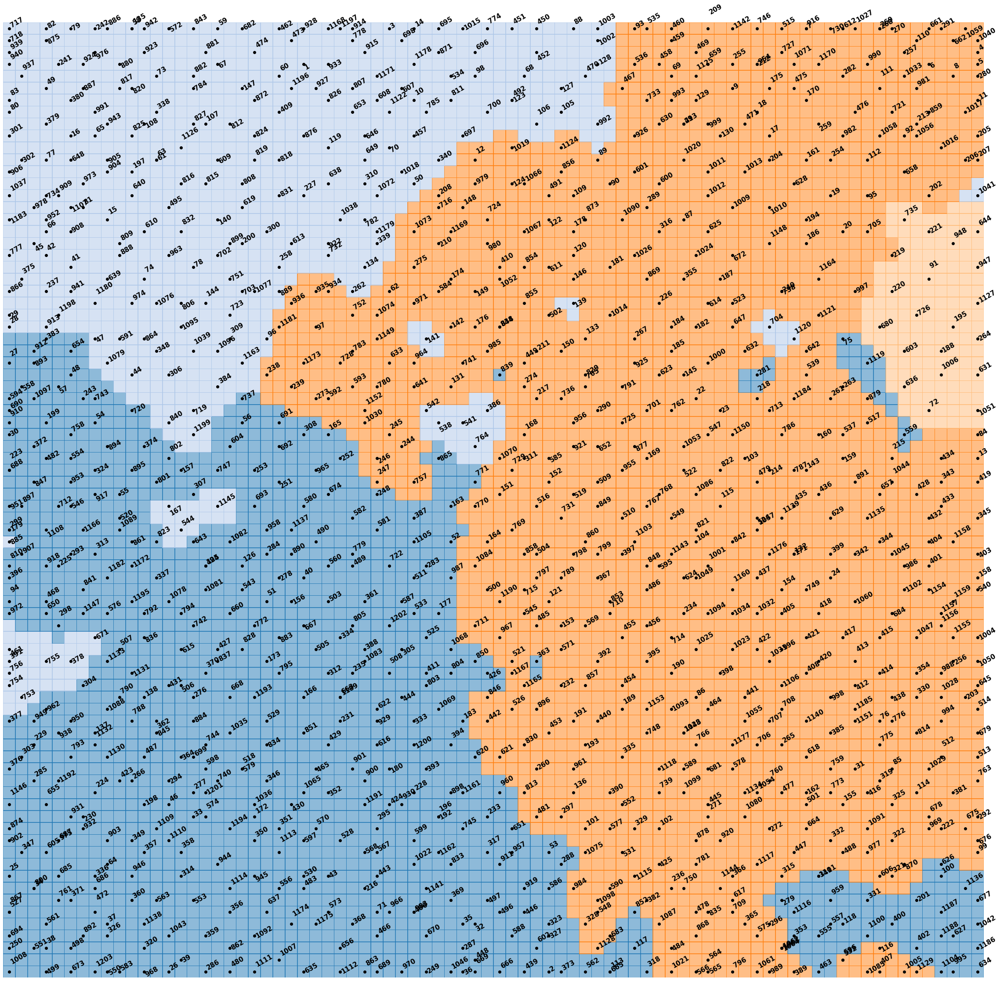

In [95]:
n_clusters = 4

cmap = plt.get_cmap("tab20")
n_palette = 20  # number of different colors in this color palette
color_list = [cmap((i % n_palette)/n_palette) for i in range(n_clusters)]
msz = sm.codebook.mapsize
proj = sm.project_data(sm.data_raw)
coord = sm.bmu_ind_to_xy(proj)

fig, ax = plt.subplots(1, 1, figsize=(40,40))

#cl_labels = som.cluster(n_clusters)
cl_labels = sklearn.cluster.KMeans(n_clusters = n_clusters, 
                                   random_state = 555).fit_predict(sm.codebook.matrix)

# fill each rectangular unit area with cluster color
# and draw line segment to the border of cluster
norm = mpl.colors.Normalize(vmin=0, vmax=n_palette, clip=True)

# borders
ax.pcolormesh(cl_labels.reshape(msz[0], msz[1]).T % n_palette,
            cmap=cmap, norm=norm, edgecolors='face',
            lw=0.5, alpha=0.5)

ax.scatter(coord[:, 0]+0.5, coord[:, 1]+0.5, c='k', marker='o')
ax.axis('off')


for label, x, y in zip(labels, coord[:, 0], coord[:, 1]):
    x += 0.2
    y += 0.2
    # "+ 0.1" means shift of label location to upperright direction

    # randomize the location of the label not to be overwrapped with each other
    # x_text += 0.1 * np.random.randn()
    y += 0.3 * np.random.randn()

    # wrap of label for chemical compound
    # label = str_wrap(label)

    ax.text(x+0.3, y+0.3, label,
            horizontalalignment='left', verticalalignment='bottom',
            rotation=30, fontsize=15, weight='semibold')

# plt.savefig('Images/cluster/cluster_HOMO_Mw.png')

In [19]:
def clusteringmap_category(sm,n_clusters,dataset,colorcategory, savepath):
    """
    Description:
    This function is used to output maps that prints colors on dots based
    on their properties
    """
    categories = dataset[colorcategory] #if colorcategory is one col of the dataset
    cmap = plt.get_cmap("tab20") #cmap for background
    n_palette = 20  # number of different colors in this color palette
    color_list = [cmap((i % n_palette)/n_palette) for i in range(n_clusters)]
    msz = sm.codebook.mapsize
    proj = sm.project_data(sm.data_raw)
    coord = sm.bmu_ind_to_xy(proj)

    fig, ax = plt.subplots(1, 1, figsize=(30,30))

    cl_labels = sklearn.cluster.KMeans(n_clusters=n_clusters,random_state=555).fit_predict(sm.codebook.matrix)
        
    # fill each rectangular unit area with cluster color
    #  and draw line segment to the border of cluster
    norm = mpl.colors.Normalize(vmin=0, vmax=n_palette, clip=True)
#     ax.pcolormesh(cl_labels.reshape(msz[0], msz[1]).T % n_palette,
#                 cmap=cmap, norm=norm, edgecolors='face',
#                 lw=0.5, alpha=0.5)

    ax.scatter(coord[:, 0]+0.5, coord[:, 1]+0.5, c='k', marker='o')
    ax.axis('off')

    categoryname = list(dataset.groupby(colorcategory).count().index)
    categories_int = categories.apply(categoryname.index)

    N = len(categoryname)
    cmap_labels = plt.cm.gist_ncar
    # extract all colors from the .jet map
    cmaplist = [cmap_labels(i) for i in range(cmap_labels.N)]
    # create the new map
    cmap_labels = cmap_labels.from_list('Custom cmap', cmaplist, cmap_labels.N)
    # define the bins and normalize
    bounds = np.linspace(0,N,N+1)
    norm_labels = mpl.colors.BoundaryNorm(bounds, cmap_labels.N)

    scat = ax.scatter(coord[:, 0]+0.5, coord[:, 1]+0.5, c=categories_int,s=300,cmap=cmap_labels,norm=norm_labels)
    cbar = plt.colorbar(scat, spacing='proportional',ticks=bounds)
    cbar.ax.get_yaxis().set_ticks([])
    
    for j, lab in enumerate(categoryname):
        cbar.ax.text(1, (2 * j + 1) / (2*(len(categoryname))), lab, ha='left', va='center', fontsize=30)
    cbar.ax.get_yaxis().labelpad = 15
    # cbar.ax.set_ylabel('# of contacts', rotation=270)
    ax.axis('off')

    for x, y in zip(coord[:, 0], coord[:, 1]):
        x += 0.2
        y += 0.2
        # "+ 0.1" means shift of label location to upperright direction

        # randomize the location of the label
        #   not to be overwrapped with each other
        # x_text += 0.1 * np.random.randn()
        y += 0.3 * np.random.randn()

        # wrap of label for chemical compound
        #label = str_wrap(label)

        # ax.text(x+0.3, y+0.3,horizontalalignment='left', verticalalignment='bottom',rotation=30, fontsize=12, weight='semibold')
    # cl_labels = som.cluster(n_clusters)
    cl_labels = sklearn.cluster.KMeans(n_clusters = n_clusters, 
                                       random_state = 555).fit_predict(sm.codebook.matrix)

    for i in range(len(cl_labels)):
        rect_x = [i // msz[1], i // msz[1],
                i // msz[1] + 1, i // msz[1] + 1]
        rect_y = [i % msz[1], i % msz[1] + 1,
                i % msz[1] + 1, i % msz[1]]

        if i % msz[1] + 1 < msz[1]:  # top border
            if cl_labels[i] != cl_labels[i+1]:
                ax.plot([rect_x[1], rect_x[2]],
                        [rect_y[1], rect_y[2]], 'k-', lw=2.5)

        if i + msz[1] < len(cl_labels):  # right border
            if cl_labels[i] != cl_labels[i+msz[1]]:
                ax.plot([rect_x[2], rect_x[3]],
                        [rect_y[2], rect_y[3]], 'k-', lw=2.5)

    plt.savefig(savepath)
    return cl_labels

In [20]:
# data['PCE_Categ'] = classify_by_group(data,"PCE_ave",5)
# clusteringmap_category(sm,5,data,"PCE_Categ",'./Images/descriptors/Mw_HOMO/PCE_Categ.png')

In [21]:
def sort_by_range(data, min_val, max_val, prop, Categ):
    """
    This function gives values between min and max as 0
    values outside as 1
    """
    ls = []
    df_categ = data[Categ]
    for i in range(len(data[prop])):
        if max_val >= data[prop].iloc[i] >= min_val:
            df_categ.iloc[i] = 0
        else:
            df_categ.iloc[i]  = 1
        ls.append(df_categ.iloc[i])
    return ls

In [22]:
data['n5Ring_Categ'] = classify_by_group(data, "n5Ring", 5)

In [23]:
# this function is used for data processing - creating categories
def classify_by_group2(data,prop,k):
    
    """
    This function is to append the normalized PCE_ave data to a 
    new column, prop is the property name string, k is number of 
    group
    """
    
    min_value = min(data[prop])
    max_value = max(data[prop])
    ls = []
    
    for i in range(len(data[prop])):
        norm = (data[prop].iloc[i]-min_value)/(max_value - min_value)
        new_val = np.round(norm * k)
        for n, i in enumerate(ls):
            if i == 0:
                ls[n] = 1
        ls.append(new_val)
    return ls

locator: <matplotlib.ticker.FixedLocator object at 0x000002170931C4A8>
Using fixed locator on colorbar
Setting pcolormesh
findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=30.0.
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymReg.ttf) normal normal regular normal>) = 10.05
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono-BoldOblique.ttf) oblique normal bold normal>) = 11.335
findfont: score(<Font 'cmsy10' (cmsy10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmss10' (cmss10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans-Oblique.ttf) oblique normal 400 normal>) = 1.05
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal bold normal>) = 10.335
f

findfont: score(<Font 'ESSTIXFive' (ESSTIX5_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Times New Roman' (times.ttf) normal normal roman normal>) = 10.145
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Malgun Gothic' (malgun.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Courant' (CON_____.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Courant' (COO_____.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'ESSTIXOne' (ESSTIX1_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriab.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal bold condensed>) = 10.535
findfont: score(<Font 'Rockwell' (ROCKI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Segoe UI' (segoeuii.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_I.TTF) italic

findfont: score(<Font 'Gill Sans MT' (GILB____.TTF) normal normal bold normal>) = 10.335
findfont: score(<Font 'Niagara Engraved' (NIAGENG.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Candara' (Candara.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Symbol' (symbol.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Goudy Stout' (GOUDYSTO.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguibli.ttf) italic normal black normal>) = 11.525
findfont: score(<Font 'HoloLens MDL2 Assets' (holomdl2.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Arial' (ariblk.ttf) normal normal black normal>) = 6.888636363636364
findfont: score(<Font 'Yu Gothic' (YuGothB.ttc) normal normal bold normal>) = 10.335
findfont: score(<Font 'Matura MT Script Capitals' (MATURASC.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STSong' (STSONG.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Leelawadee UI' 

findfont: score(<Font 'Helonia' (HEB_____.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal demi normal>) = 10.24
findfont: score(<Font 'Wingdings' (wingding.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'MingLiU-ExtB' (mingliub.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSansCondensed-BoldOblique.ttf) oblique normal bold condensed>) = 1.535
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Modern No. 20' (MOD20.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constanb.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'ESSTIXSeven' (ESSTIX7_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Courier New' (courbi.ttf) italic normal bold normal>) = 11.335
findfont: score(<Font 'ESSTIXThree' (ESSTIX3_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calif

findfont: score(<Font 'Candara' (Candarab.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bauhaus 93' (BAUHS93.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Malgun Gothic' (malgunbd.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Myanmar Text' (mmrtextb.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Calibri' (calibrii.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Arial' (ARIALNI.TTF) italic normal 400 condensed>) = 7.613636363636363
findfont: score(<Font 'Bookman Old Style' (BOOKOS.TTF) normal normal book normal>) = 10.05
findfont: score(<Font 'Microsoft PhagsPa' (phagspab.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Playbill' (PLAYBILL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'ESSTIXNine' (ESSTIX9_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Roboto' (Roboto-B

findfont: score(<Font 'Franklin Gothic Demi Cond' (FRADMCN.TTF) normal normal demi condensed>) = 10.44
findfont: score(<Font 'Adobe Devanagari' (AdobeDevanagari-Italic.otf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Yu Gothic' (YuGothR.ttc) normal normal regular normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Times New Roman' (timesbd.ttf) normal normal roman normal>) = 10.145
findfont: score(<Font 'MS Outlook' (OUTLOOK.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Elephant' (ELEPHNT.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'icon-large' (icon-large.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibri.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'icon-ui' (icon-ui.ttf) normal normal 400 normal>) = 10.05
findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal

array([0, 0, 0, ..., 2, 2, 2])

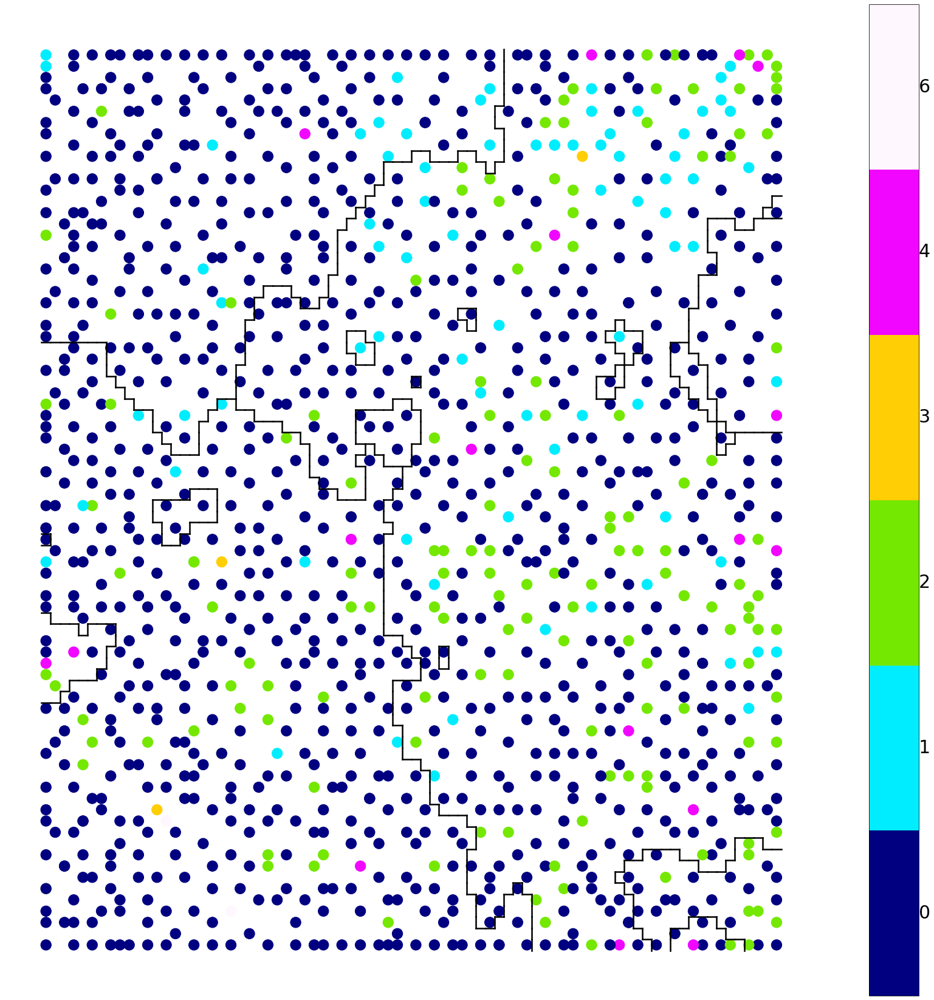

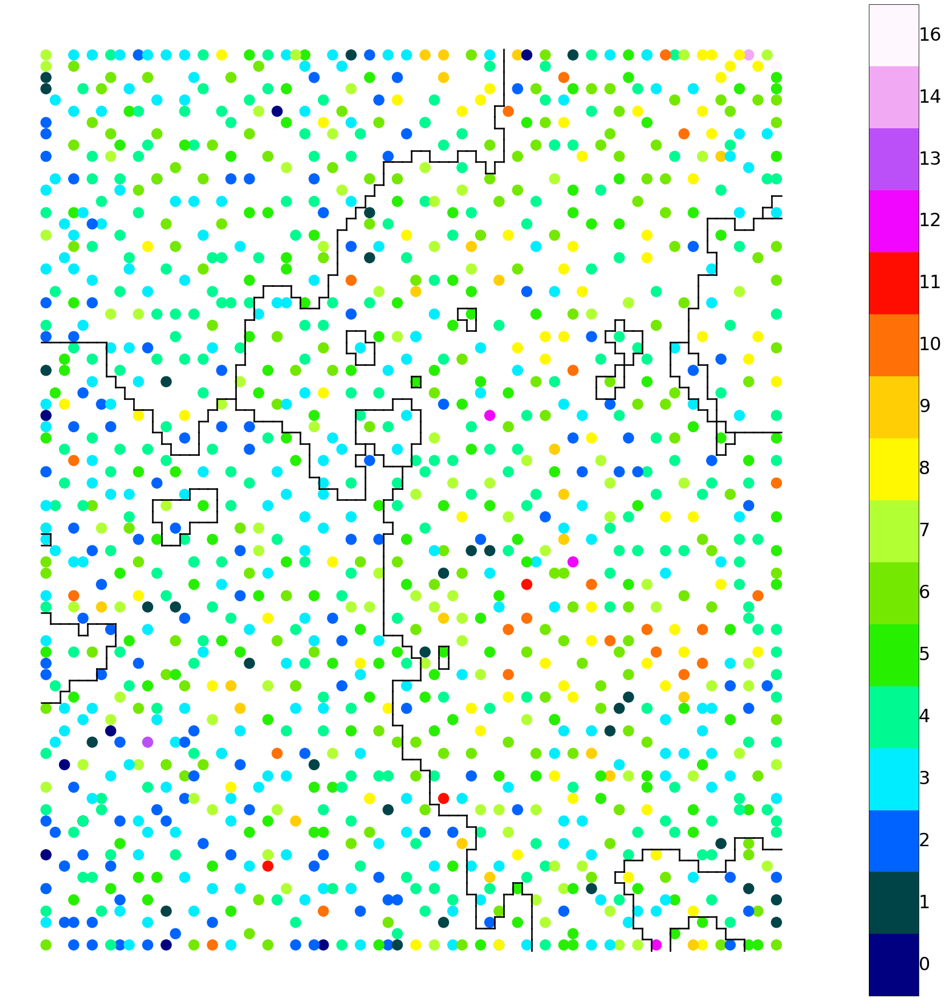

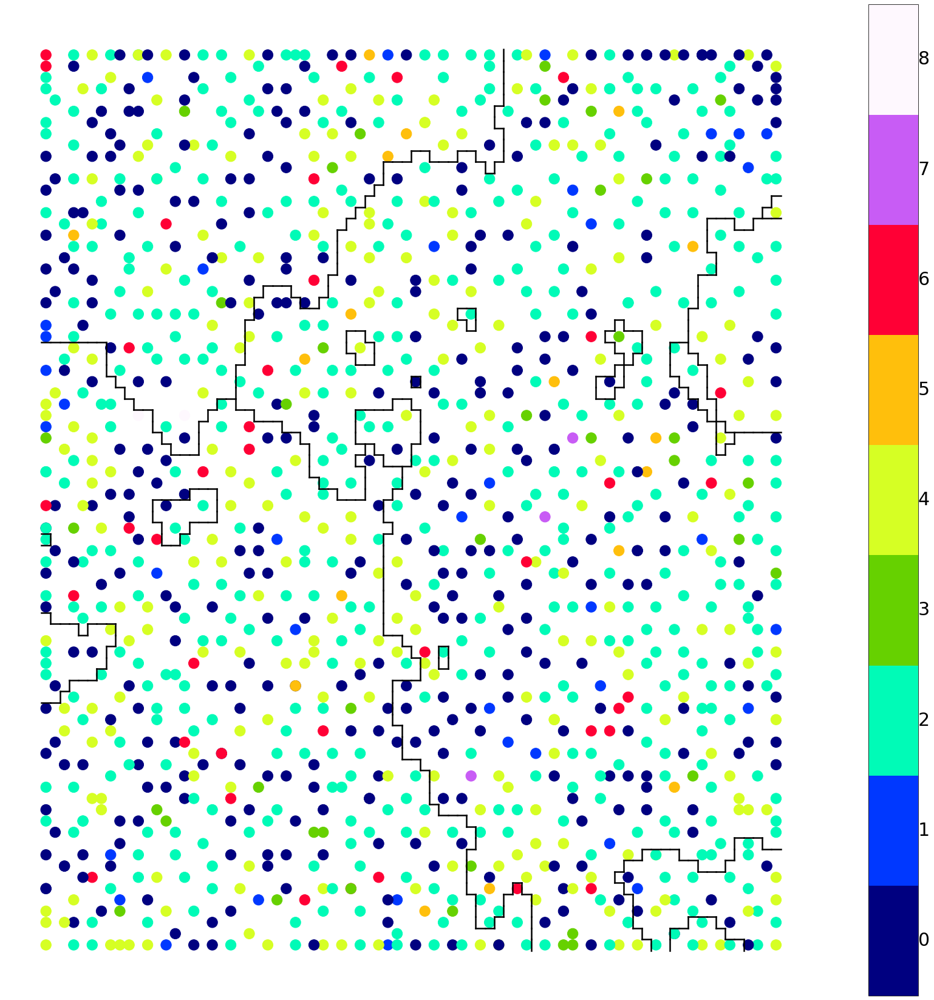

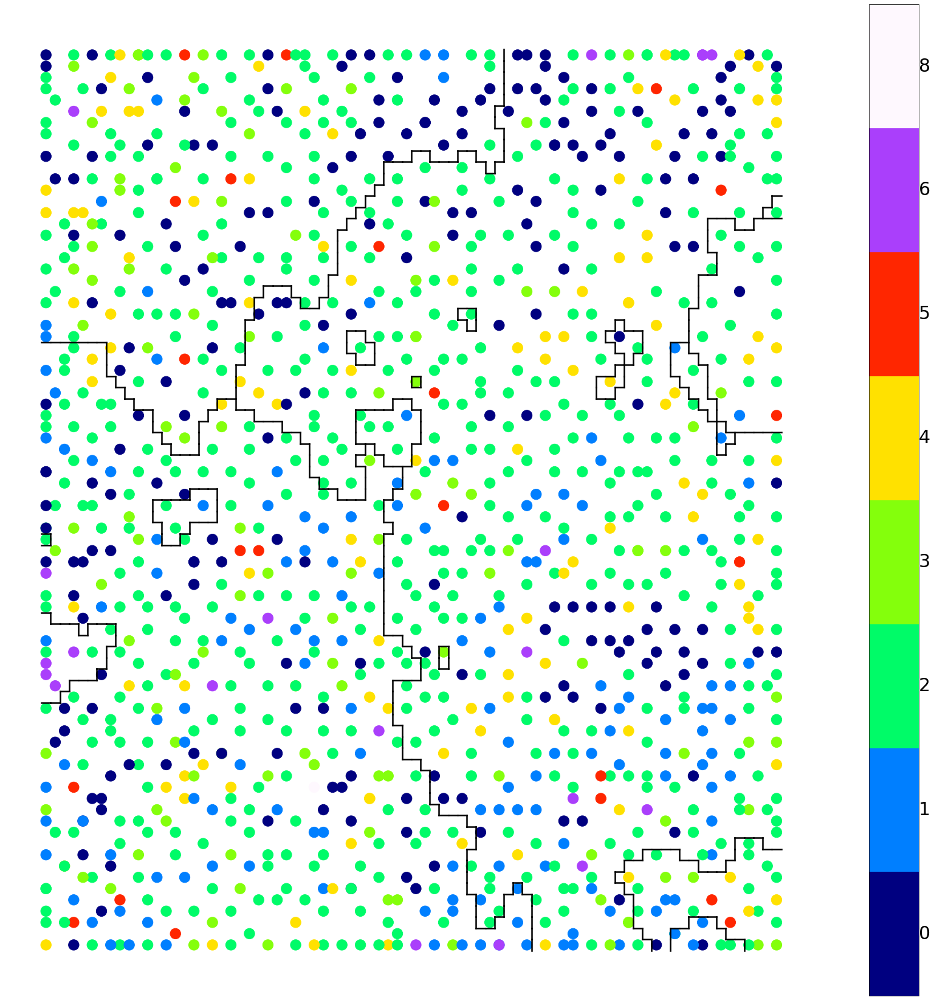

In [24]:
clusteringmap_category(sm,4,data,"nF",'./Images/descriptors/Mw_HOMO/nF.png')
clusteringmap_category(sm,4,data,"nS",'./Images/descriptors/Mw_HOMO/nS.png')
clusteringmap_category(sm,4,data,"nO",'./Images/descriptors/Mw_HOMO/nO.png')
# the materials with higheset PCE (several white ones) lack nitrogen (N)
clusteringmap_category(sm,4,data,"nN",'./Images/descriptors/Mw_HOMO/nN.png')

In [25]:
data['nF_Categ1'] = classify_by_group2(data, "nF", 6)
data['nS_Categ'] = classify_by_group2(data, "nS", 6)
data['nO_Categ'] = classify_by_group2(data, "nO", 6)
data['nN_Categ'] = classify_by_group2(data, "nN", 6)
data['nCl_Categ'] = classify_by_group2(data, "nCl", 6)

# avoid columns with all zeros, like Cl

In [30]:
mini = min(data['nF'])
maxi = max(data['nF'])
ls = data['nF']
std = (maxi-ls[1203])/(maxi-mini)
std

1.0

locator: <matplotlib.ticker.FixedLocator object at 0x000001FEDA9D7B38>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001FED730DA90>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001FED64B0A90>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001FEE0F2DF28>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001FEE0FD6E48>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

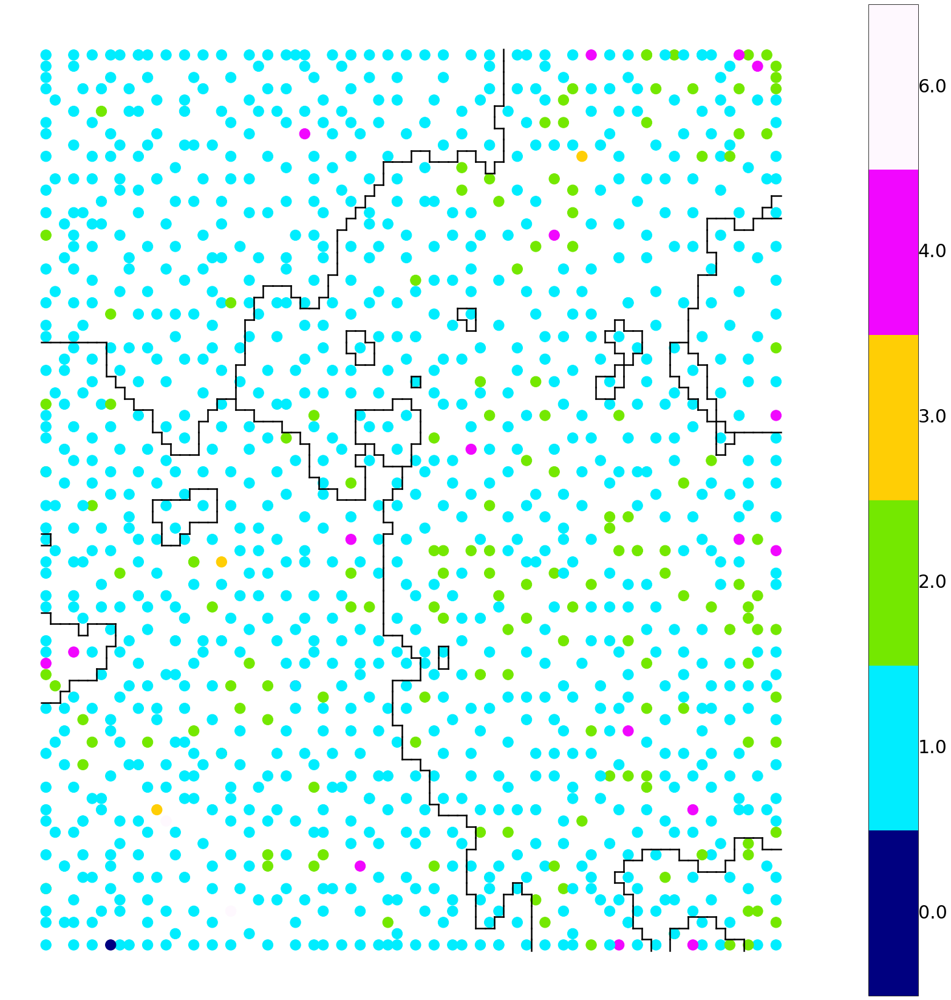

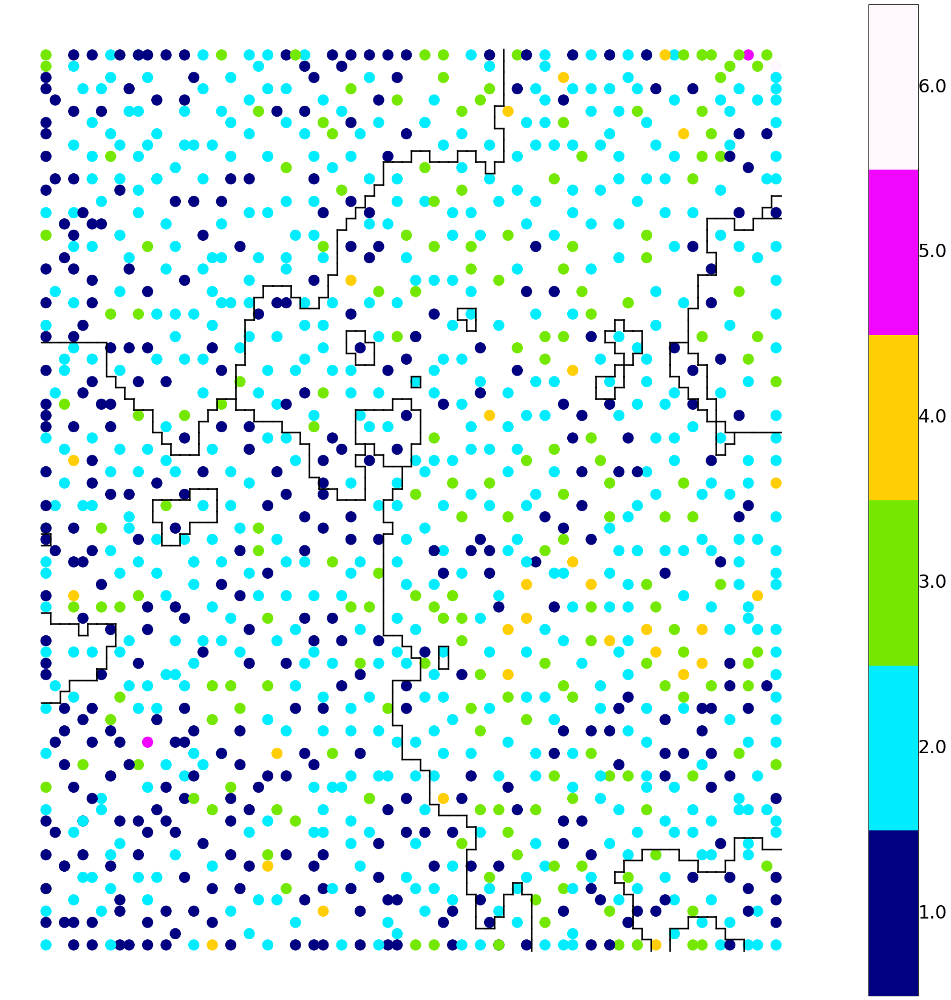

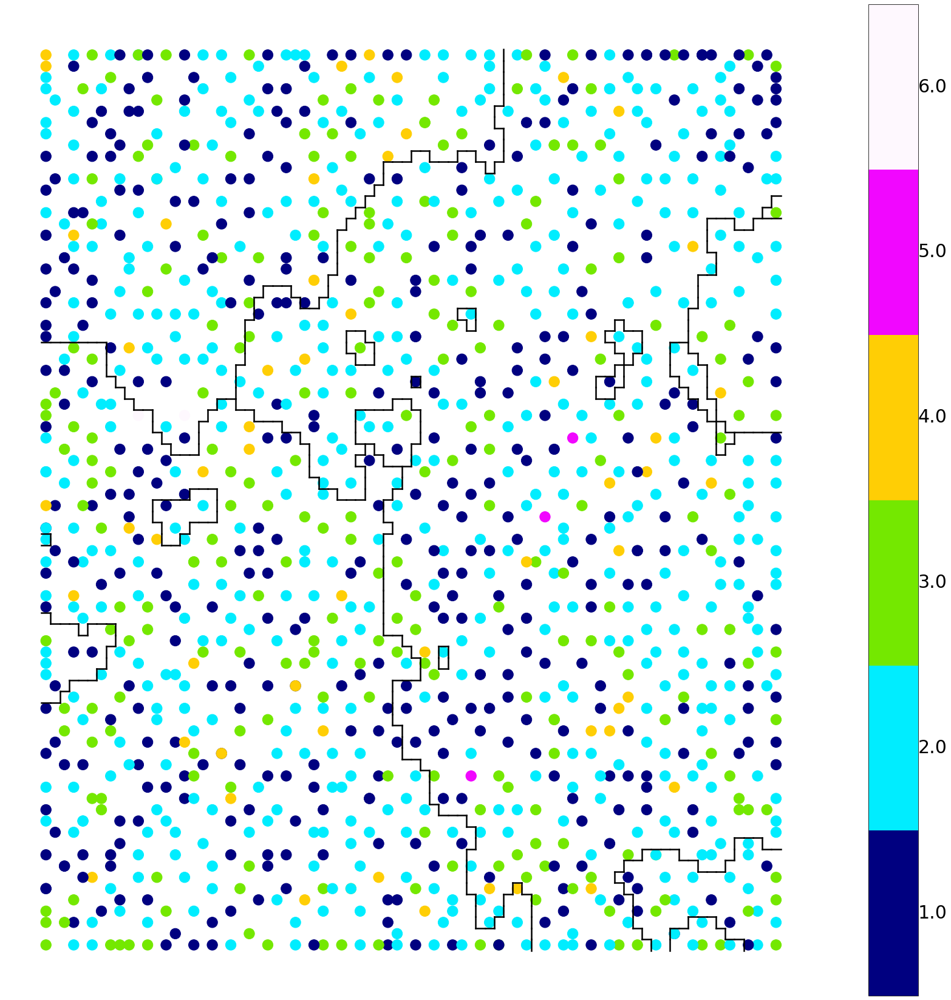

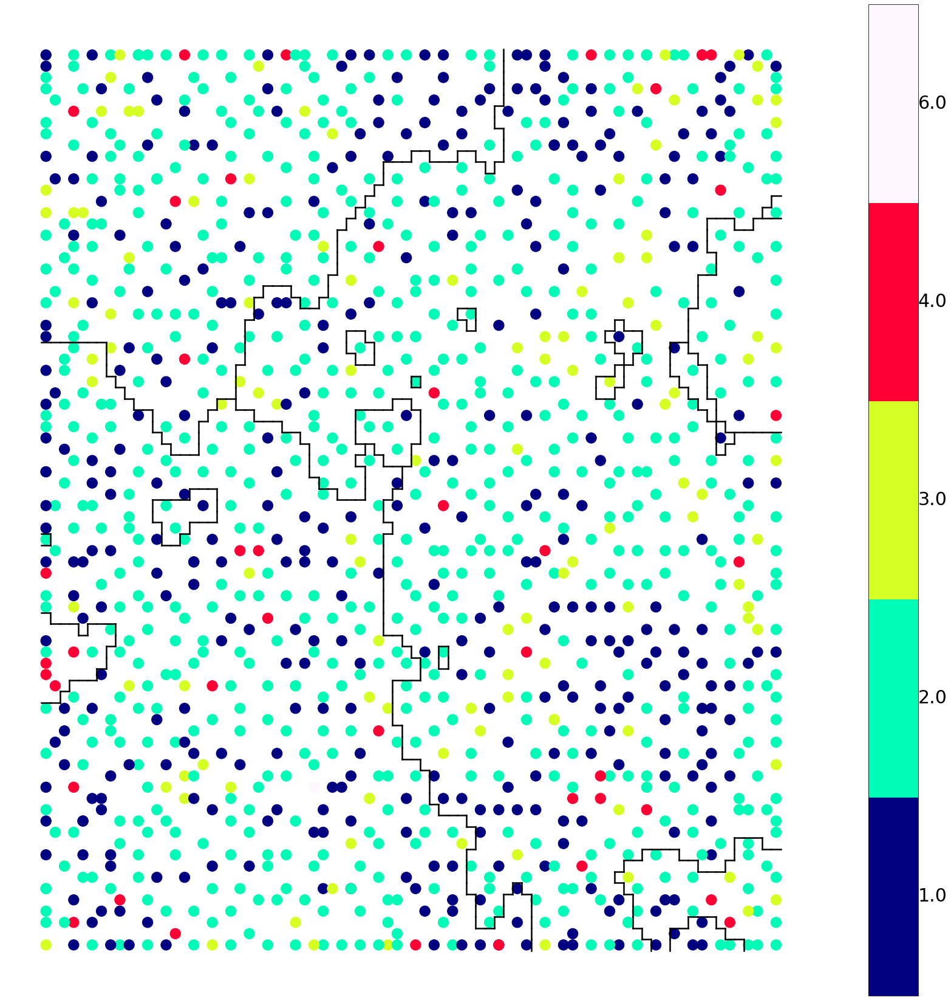

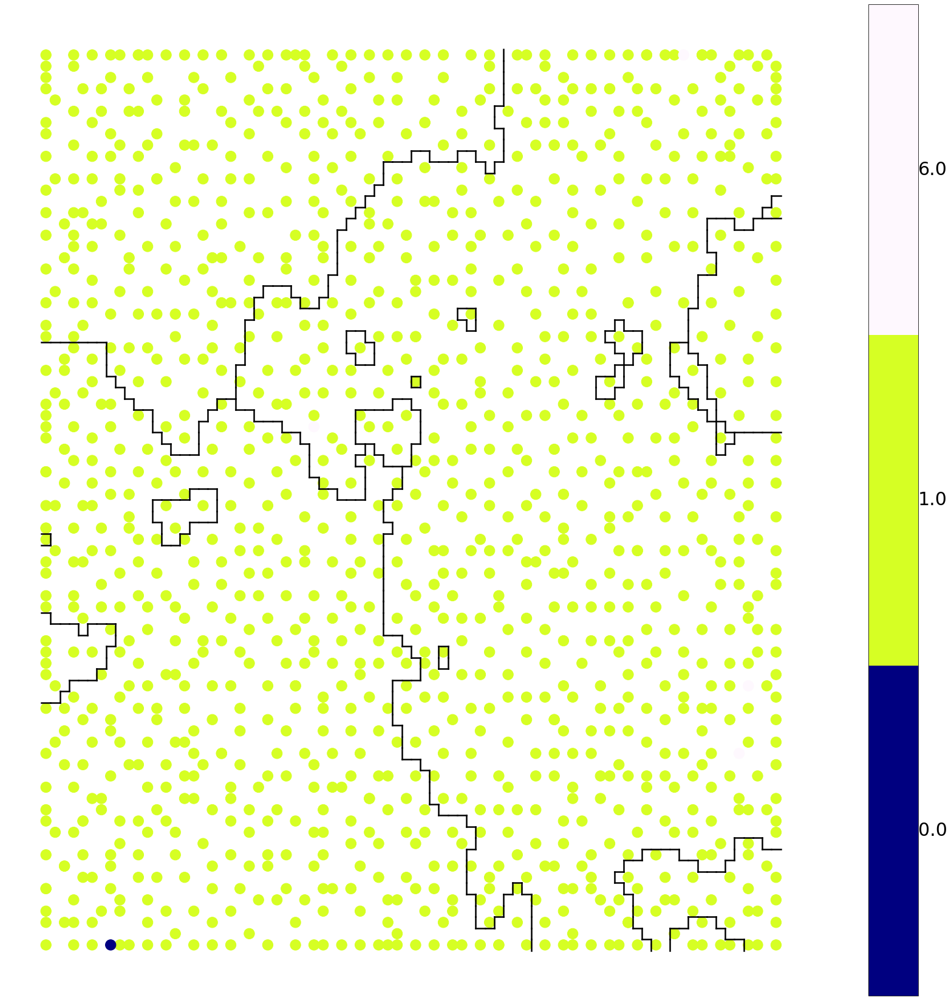

In [25]:
clusteringmap_category(sm,4,data,"nF_Categ",'./Images/descriptors/Mw_HOMO/nF_Categ.png')
clusteringmap_category(sm,4,data,"nS_Categ",'./Images/descriptors/Mw_HOMO/nS_Categ.png')
clusteringmap_category(sm,4,data,"nO_Categ",'./Images/descriptors/Mw_HOMO/nO_Categ.png')
clusteringmap_category(sm,4,data,"nN_Categ",'./Images/descriptors/Mw_HOMO/nN_Categ.png')
clusteringmap_category(sm,4,data,"nCl_Categ",'./Images/descriptors/Mw_HOMO/nCl_Categ.png')

# clusteringmap_category(sm,4,data,"nCl_Categ",'./Images/descriptors/Mw_HOMO/nCl_Categ.png')

locator: <matplotlib.ticker.FixedLocator object at 0x00000217289F65C0>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

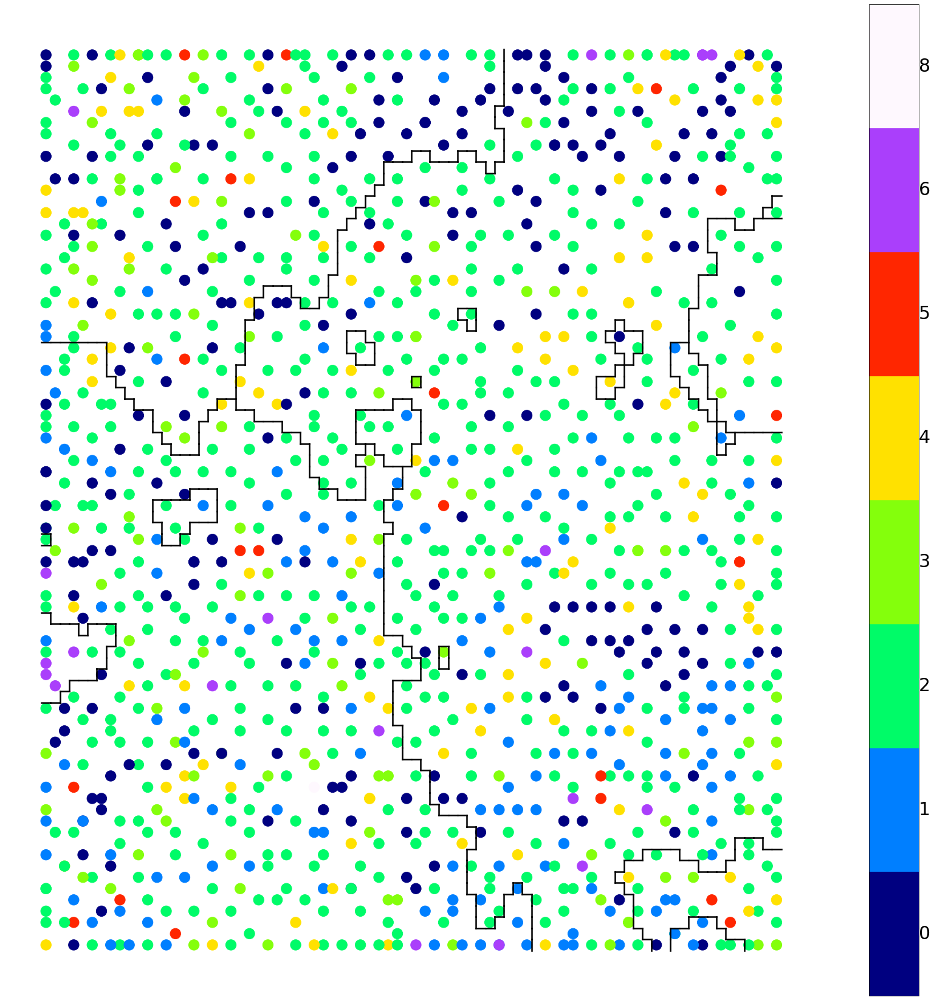

In [117]:
clusteringmap_category(sm,4,data,"nN",'./Images/descriptors/Mw_HOMO/nCl.png')

In [61]:
#data['nF35'] = sort_by_range(data, 3, 5, "nF","nF_Categ")
#data['nF12'] = sort_by_range(data, 1, 2, "nF","nF_Categ")

data['n5Ring25'] = sort_by_range(data, 3, 5, "n5Ring","n5Ring_Categ")
data['n5Ring68'] = sort_by_range(data, 6, 8, "n5Ring","n5Ring_Categ")

data['n5Ring34'] = sort_by_range(data, 3, 4, "n5Ring","n5Ring_Categ")
data['n5Ring56'] = sort_by_range(data, 5, 6, "n5Ring","n5Ring_Categ")
data['n5Ring78'] = sort_by_range(data, 7, 8, "n5Ring","n5Ring_Categ")

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\pandas\core\indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


KeyboardInterrupt: 

locator: <matplotlib.ticker.FixedLocator object at 0x000002778A119198>
Using fixed locator on colorbar
Setting pcolormesh
findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=30.0.
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymReg.ttf) normal normal regular normal>) = 10.05
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono-BoldOblique.ttf) oblique normal bold normal>) = 11.335
findfont: score(<Font 'cmsy10' (cmsy10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmss10' (cmss10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans-Oblique.ttf) oblique normal 400 normal>) = 1.05
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal bold normal>) = 10.335
f

findfont: score(<Font 'ESSTIXFive' (ESSTIX5_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Times New Roman' (times.ttf) normal normal roman normal>) = 10.145
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Malgun Gothic' (malgun.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Courant' (CON_____.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Courant' (COO_____.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'ESSTIXOne' (ESSTIX1_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriab.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal bold condensed>) = 10.535
findfont: score(<Font 'Rockwell' (ROCKI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Segoe UI' (segoeuii.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_I.TTF) italic

findfont: score(<Font 'Gill Sans MT' (GILB____.TTF) normal normal bold normal>) = 10.335
findfont: score(<Font 'Niagara Engraved' (NIAGENG.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Candara' (Candara.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Symbol' (symbol.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Goudy Stout' (GOUDYSTO.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguibli.ttf) italic normal black normal>) = 11.525
findfont: score(<Font 'HoloLens MDL2 Assets' (holomdl2.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Arial' (ariblk.ttf) normal normal black normal>) = 6.888636363636364
findfont: score(<Font 'Yu Gothic' (YuGothB.ttc) normal normal bold normal>) = 10.335
findfont: score(<Font 'Matura MT Script Capitals' (MATURASC.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STSong' (STSONG.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Leelawadee UI' 

findfont: score(<Font 'Helonia' (HEB_____.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal demi normal>) = 10.24
findfont: score(<Font 'Wingdings' (wingding.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'MingLiU-ExtB' (mingliub.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSansCondensed-BoldOblique.ttf) oblique normal bold condensed>) = 1.535
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Modern No. 20' (MOD20.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constanb.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'ESSTIXSeven' (ESSTIX7_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Courier New' (courbi.ttf) italic normal bold normal>) = 11.335
findfont: score(<Font 'ESSTIXThree' (ESSTIX3_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calif

findfont: score(<Font 'Candara' (Candarab.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bauhaus 93' (BAUHS93.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Malgun Gothic' (malgunbd.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Myanmar Text' (mmrtextb.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Calibri' (calibrii.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Arial' (ARIALNI.TTF) italic normal 400 condensed>) = 7.613636363636363
findfont: score(<Font 'Bookman Old Style' (BOOKOS.TTF) normal normal book normal>) = 10.05
findfont: score(<Font 'Microsoft PhagsPa' (phagspab.ttf) normal normal bold normal>) = 10.335
findfont: score(<Font 'Playbill' (PLAYBILL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'ESSTIXNine' (ESSTIX9_.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Roboto' (Roboto-B

findfont: score(<Font 'Franklin Gothic Demi Cond' (FRADMCN.TTF) normal normal demi condensed>) = 10.44
findfont: score(<Font 'Adobe Devanagari' (AdobeDevanagari-Italic.otf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Yu Gothic' (YuGothR.ttc) normal normal regular normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Times New Roman' (timesbd.ttf) normal normal roman normal>) = 10.145
findfont: score(<Font 'MS Outlook' (OUTLOOK.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Elephant' (ELEPHNT.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'icon-large' (icon-large.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibri.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'icon-ui' (icon-ui.ttf) normal normal 400 normal>) = 10.05
findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal

array([0, 0, 0, ..., 2, 2, 2])

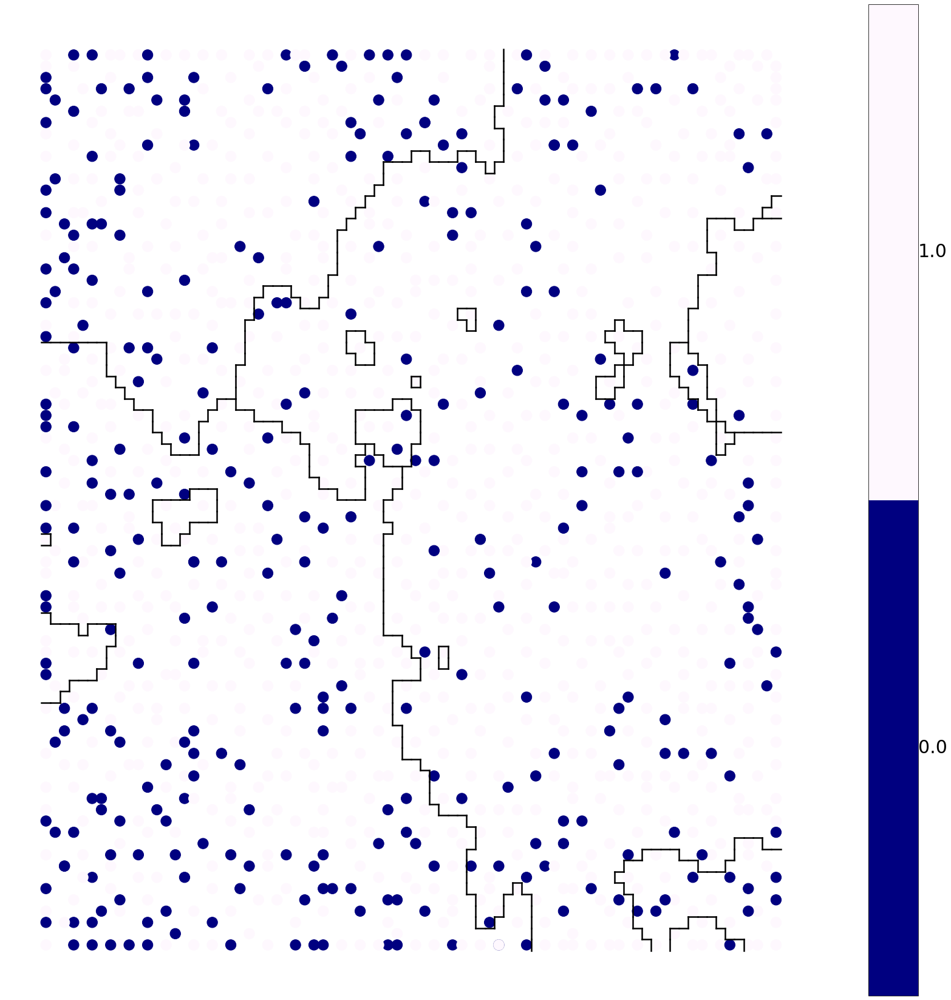

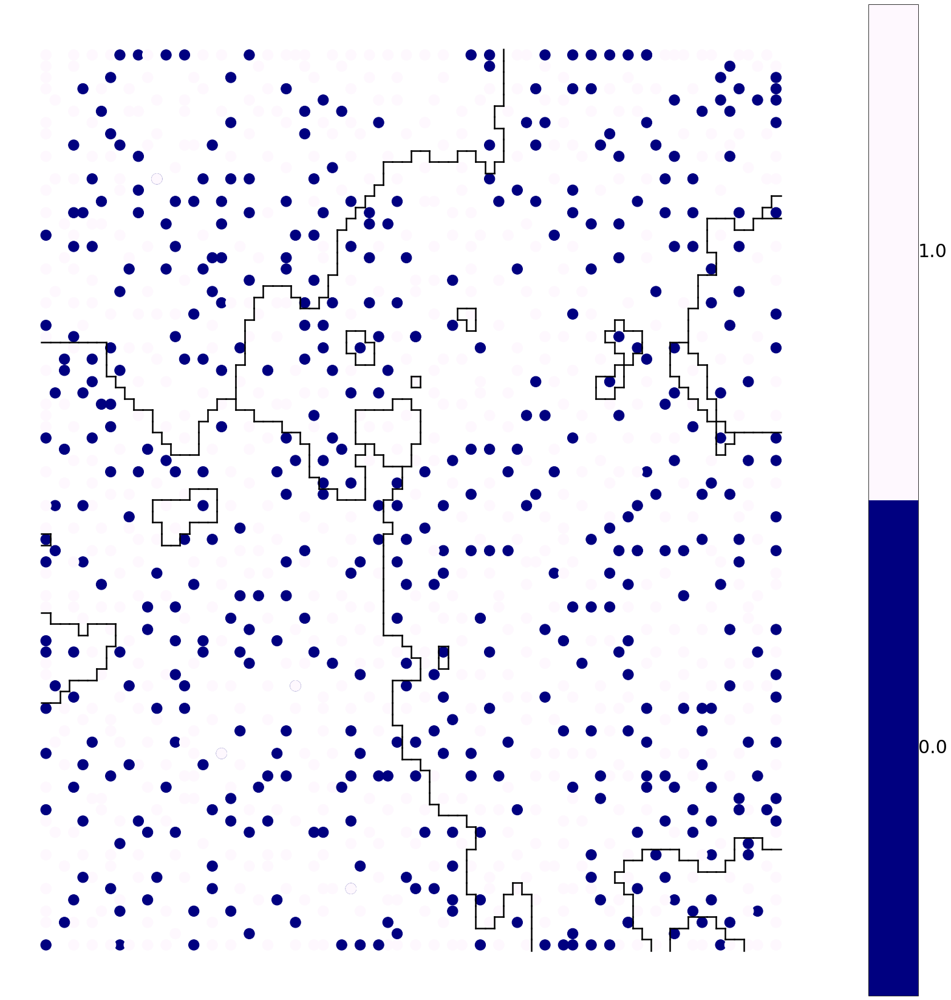

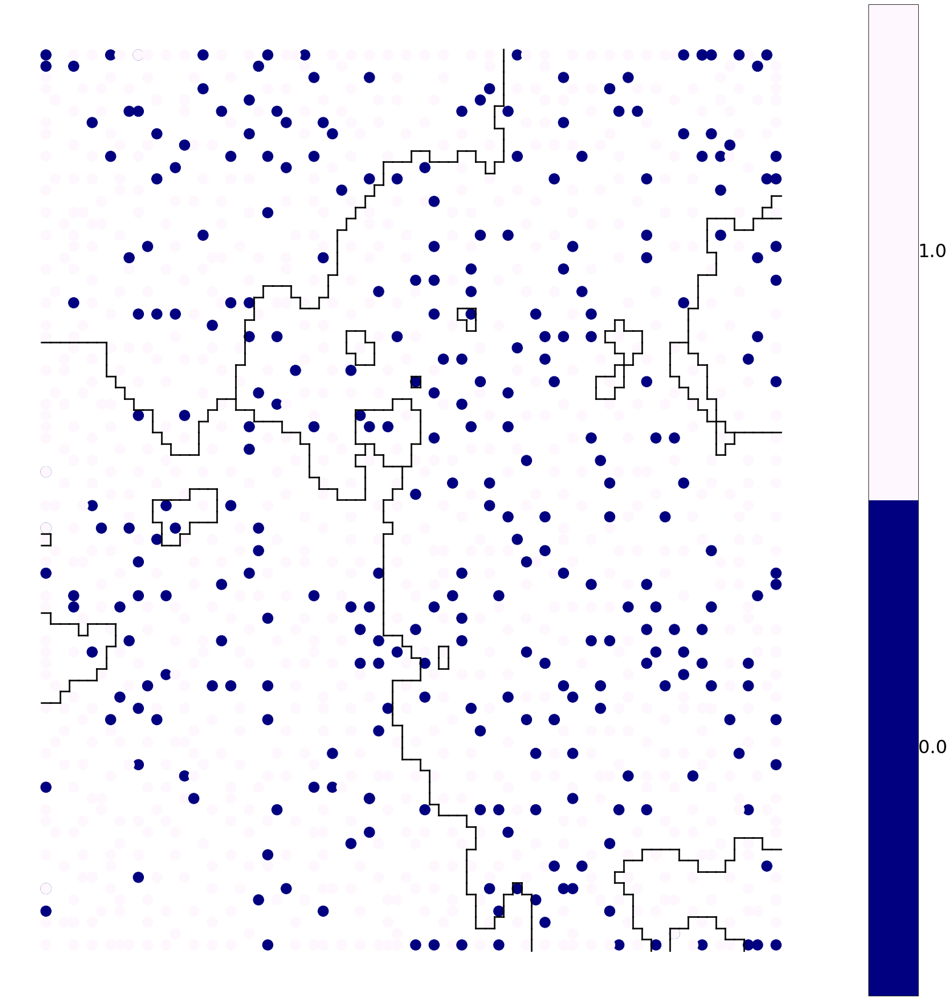

In [853]:
#clusteringmap_category(sm,4,data,"nF12",'./Images/descriptors/Mw_HOMO/nF_1_2.png')
#clusteringmap_category(sm,4,data,"nF35",'./Images/descriptors/Mw_HOMO/nF_3_5.png')

#clusteringmap_category(sm,4,data,"n5Ring25",'./Images/descriptors/Mw_HOMO/n5Ring25.png')
#clusteringmap_category(sm,4,data,"n5Ring68",'./Images/descriptors/Mw_HOMO/n5Ring68.png')

clusteringmap_category(sm,4,data,"n5Ring34",'./Images/descriptors/Mw_HOMO/n5Ring34.png')
clusteringmap_category(sm,4,data,"n5Ring56",'./Images/descriptors/Mw_HOMO/n5Ring56.png')
clusteringmap_category(sm,4,data,"n5Ring78",'./Images/descriptors/Mw_HOMO/n5Ring78.png')

Search aliphatic and aromatic atoms (it is useless right now since we know side chains play a major role)

In [1138]:
def search_carbon(data, kind):
    """
    This searches aliphatic and aromatic carbons.
    """
    smis = data.CSMILES 
    count = []
    aliph = Chem.MolFromSmarts("[C]")
    arom = Chem.MolFromSmarts("[c]")
    
    for smi in smis:
        mol = Chem.MolFromSmiles(smi)
        if kind == "aromatic":
            count.append(len(mol.GetSubstructMatches(arom)))
        elif kind == "aliphatic":
            count.append(len(mol.GetSubstructMatches(aliph)))
    return count

In [194]:
data['arom_num'] = search_carbon(data, "aromatic")
data['aliph_num'] = search_carbon(data, "aliphatic")

locator: <matplotlib.ticker.FixedLocator object at 0x000001EF054D2908>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF12A9BAC8>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

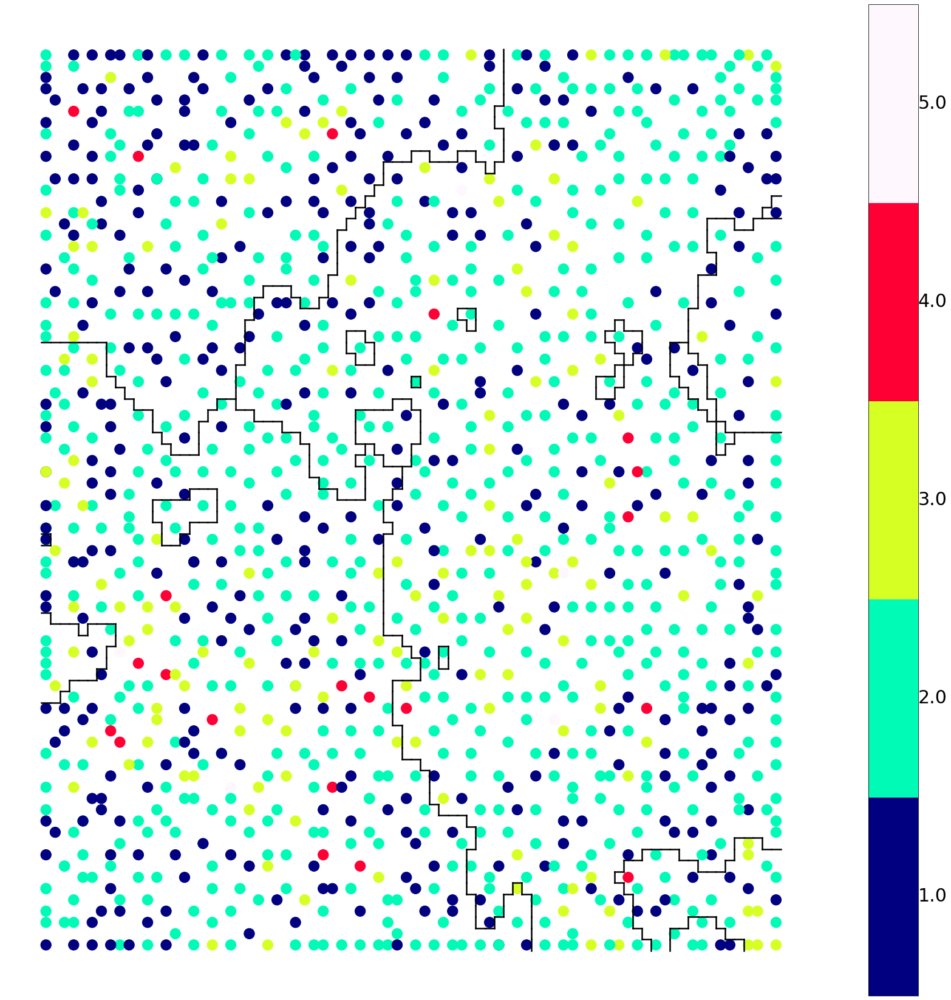

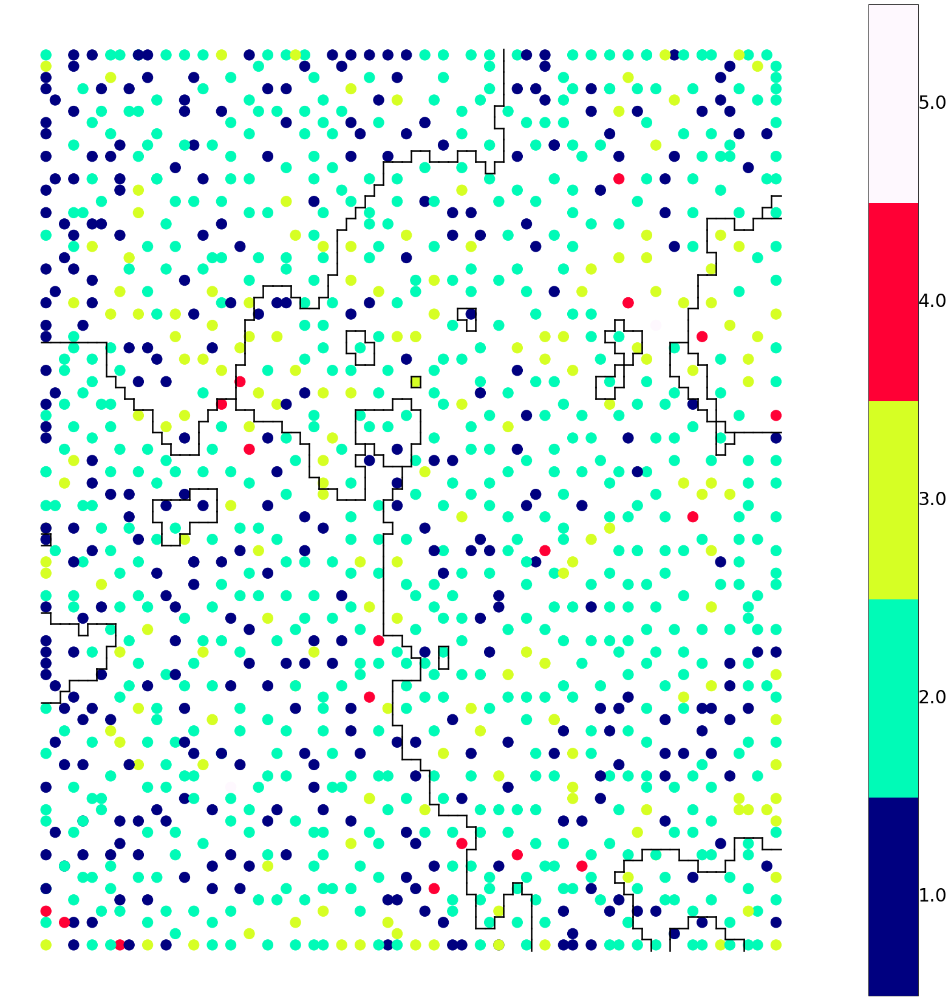

In [195]:
data['arom_Categ'] = classify_by_group(data, "arom_num", 5)
data['aliph_Categ'] = classify_by_group(data, "aliph_num", 5)

clusteringmap_category(sm,4,data,"arom_Categ",'./Images/descriptors/Mw_HOMO/arom_Categ.png')
clusteringmap_category(sm,4,data,"aliph_Categ",'./Images/descriptors/Mw_HOMO/aliph_Categ.png')

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\pandas\core\indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF03C386D8>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF054C97B8>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF11D07E80>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF11F5B908>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF041E6F60>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object

array([0, 0, 0, ..., 2, 2, 2])

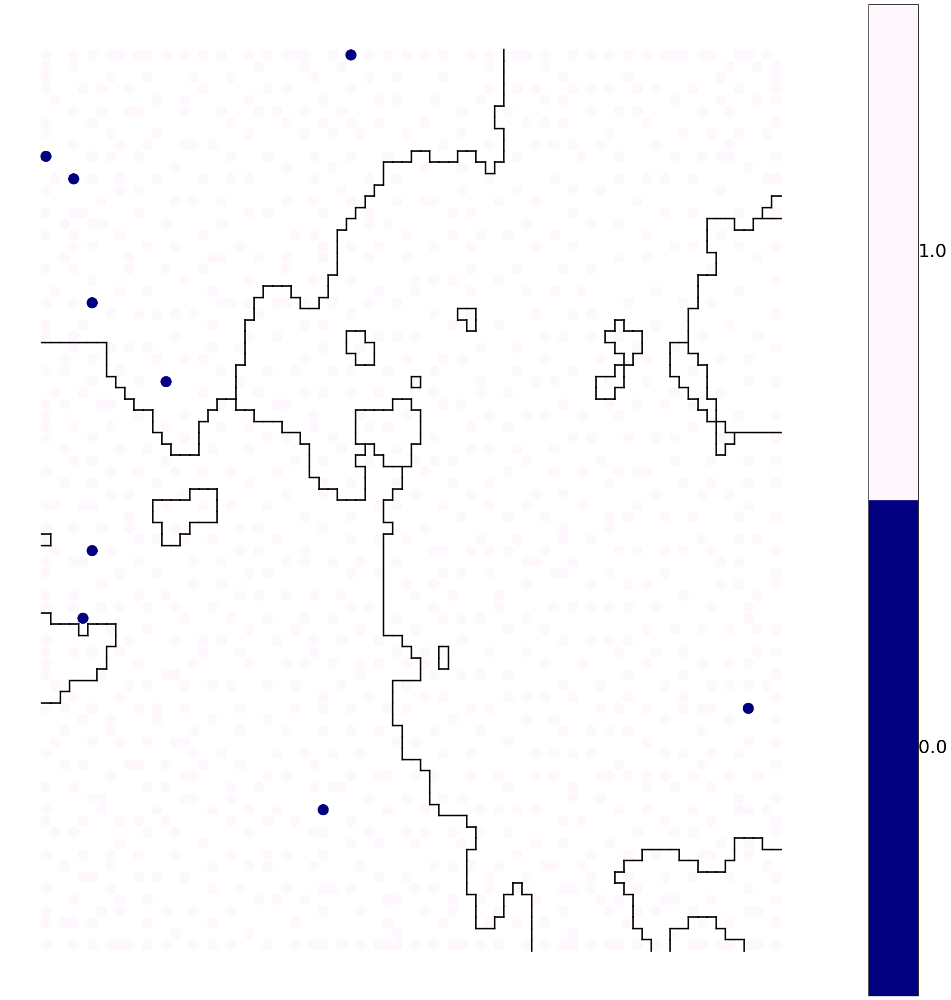

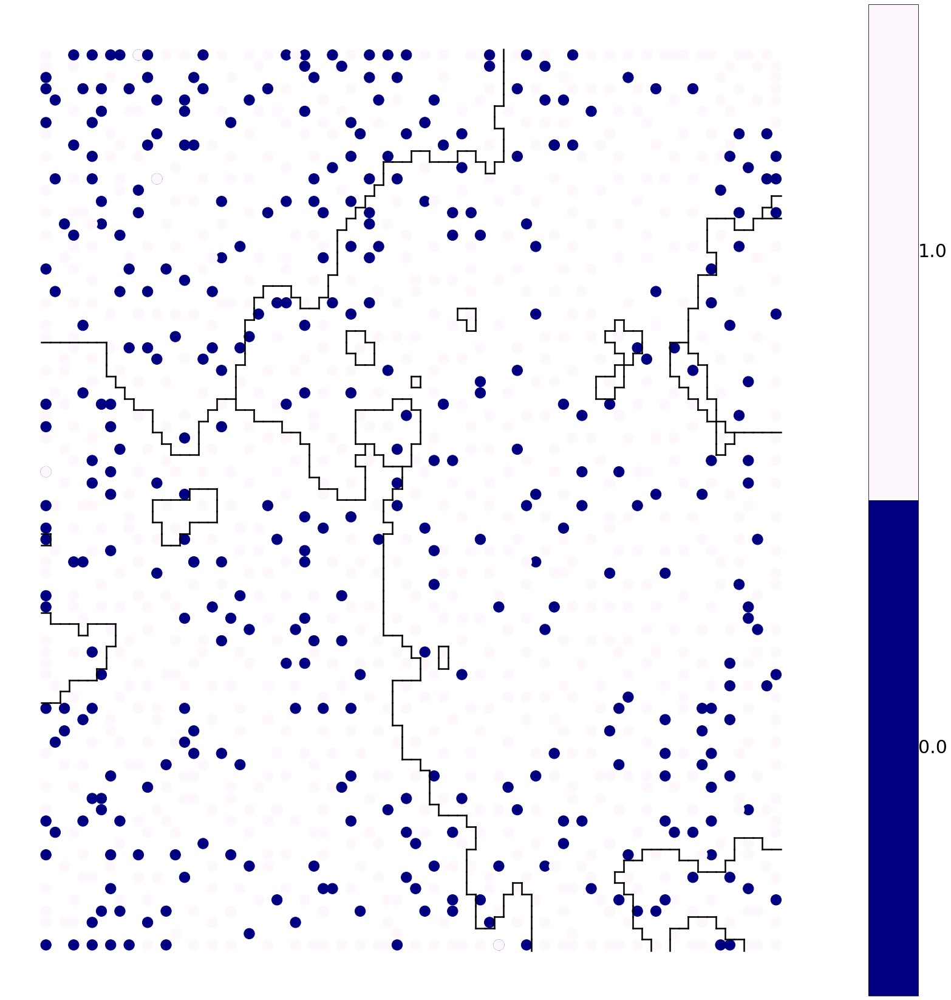

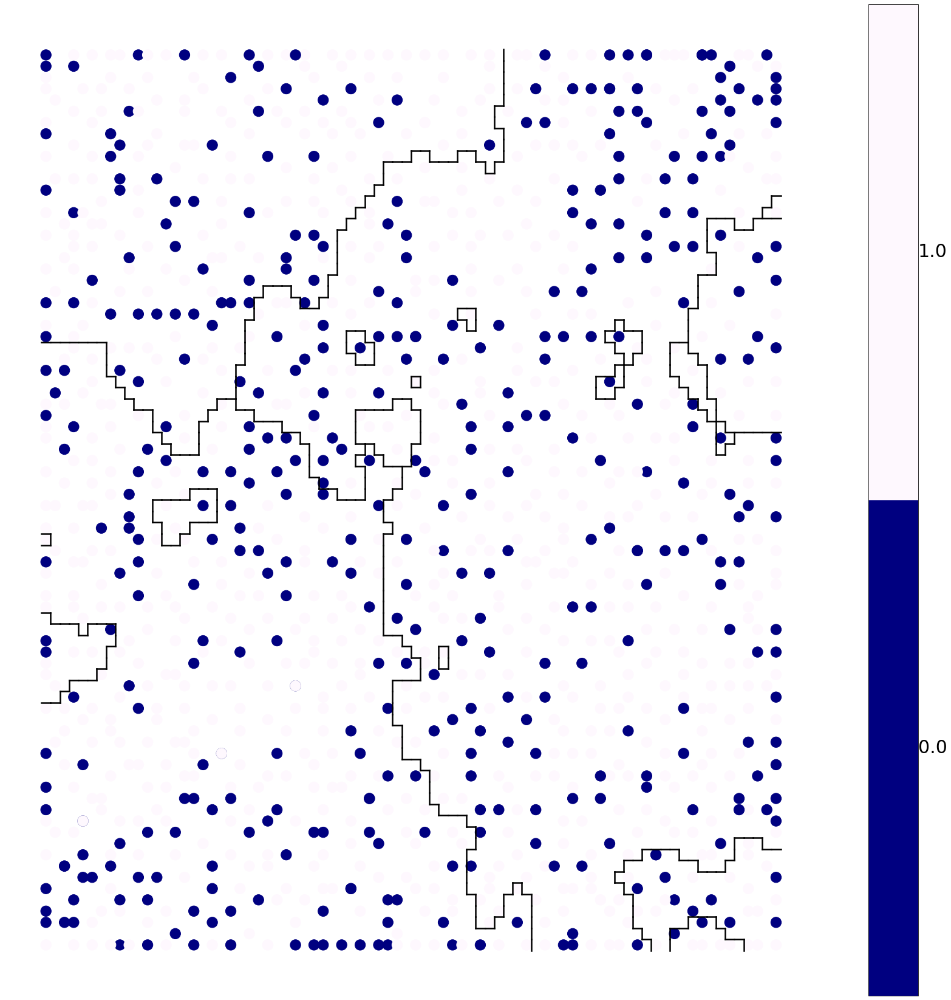

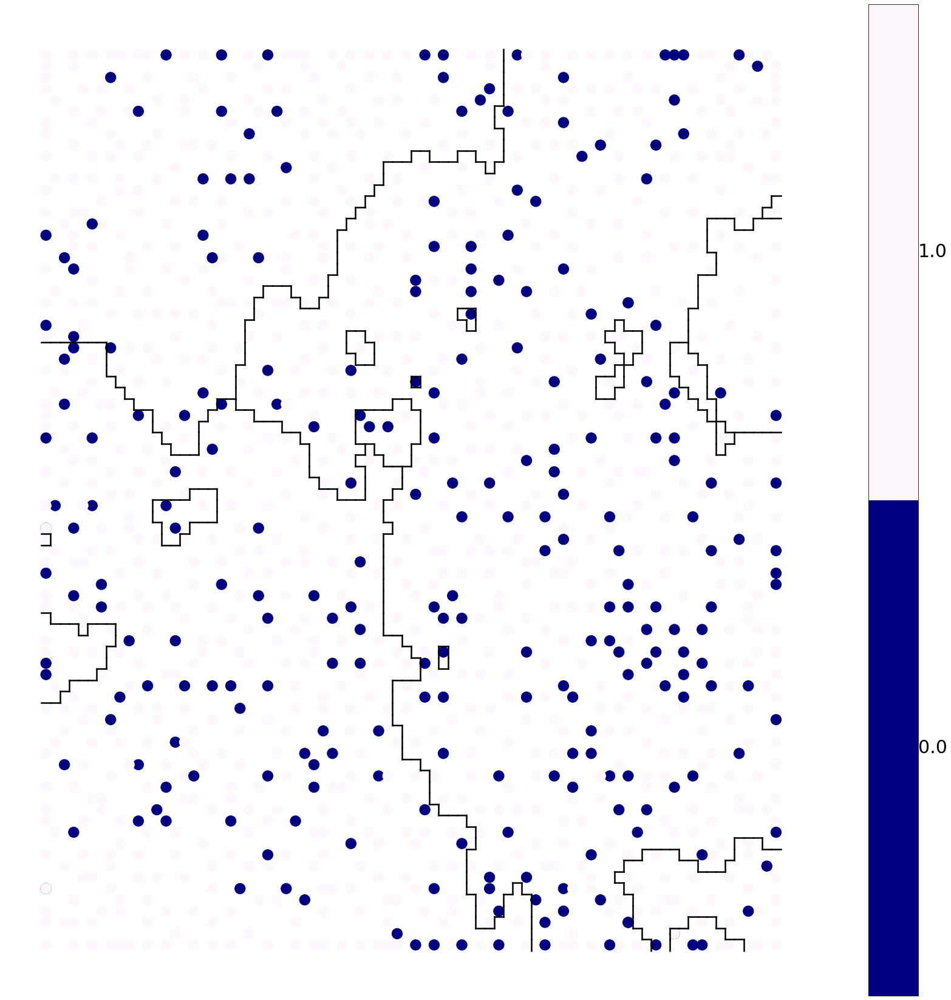

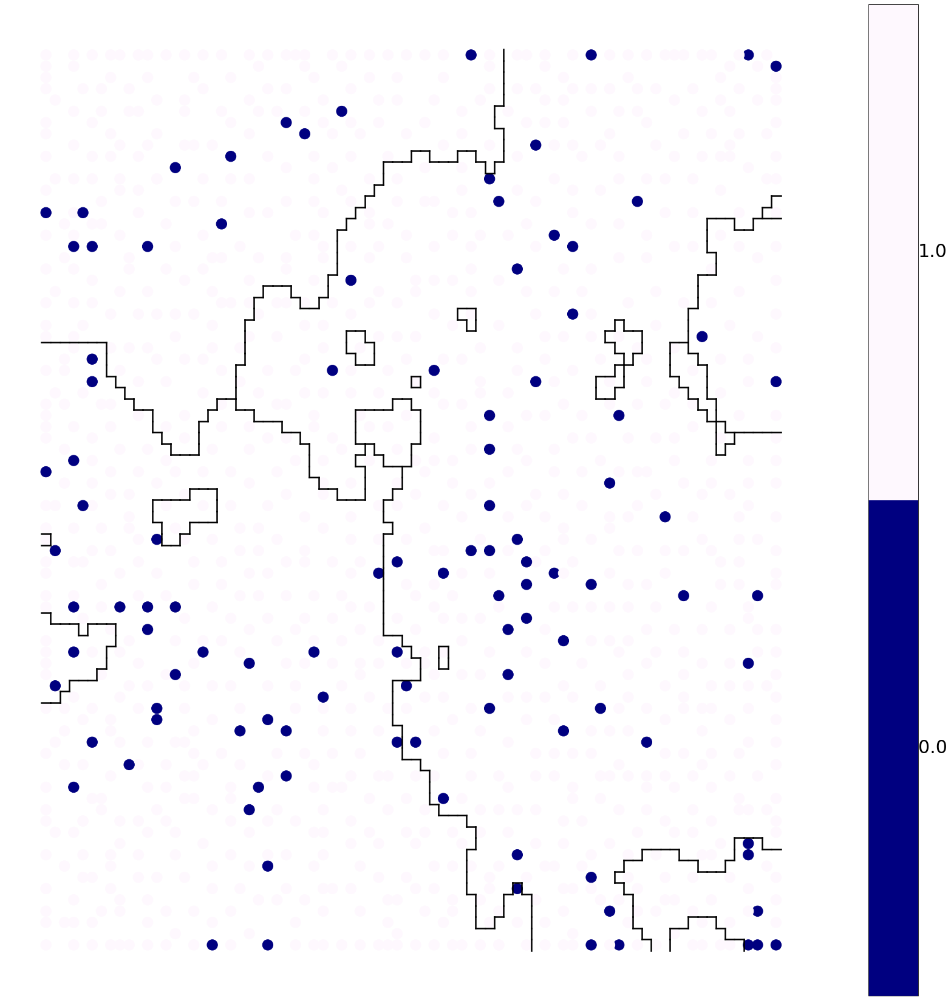

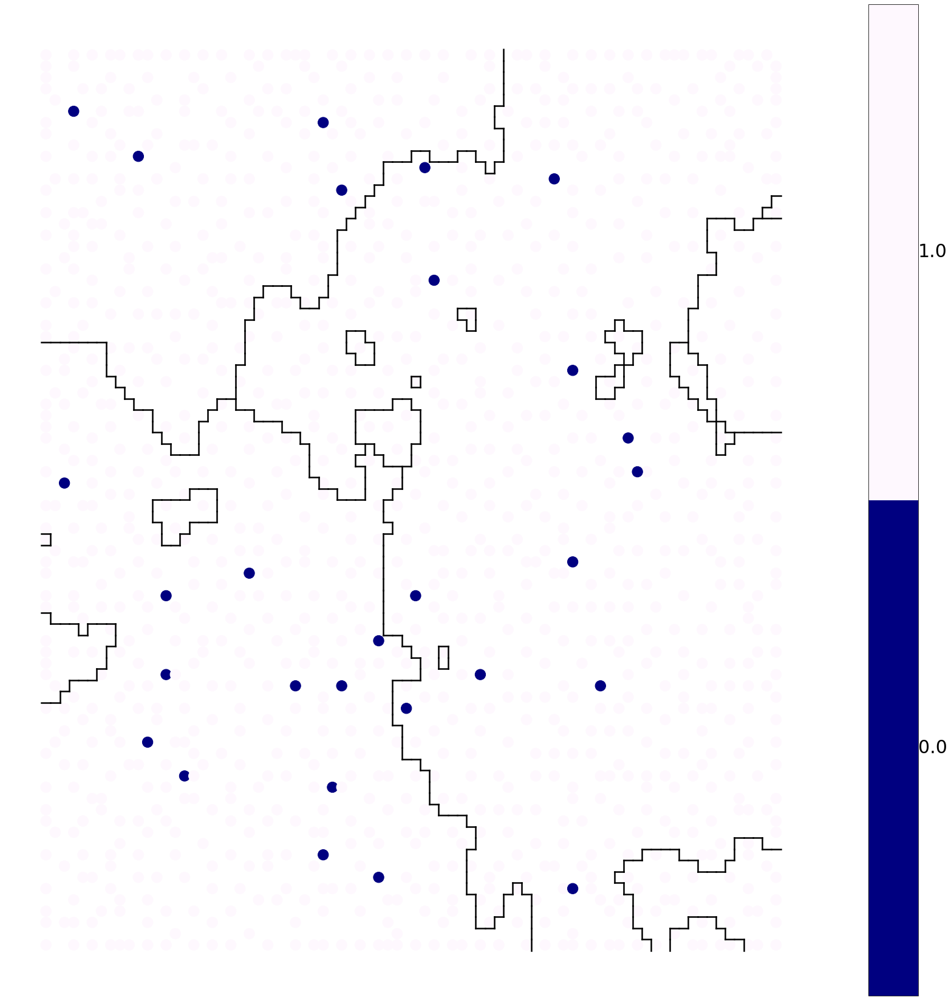

In [196]:
data['aliph_010'] = sort_by_range(data, 0, 10, "arom_num","arom_Categ")
data['aliph_1120'] = sort_by_range(data, 11, 20, "arom_num","arom_Categ")
data['aliph_2130'] = sort_by_range(data, 21, 30, "arom_num","arom_Categ")
data['aliph_3140'] = sort_by_range(data, 31, 40, "arom_num","arom_Categ")
data['aliph_4150'] = sort_by_range(data, 41, 50, "arom_num","arom_Categ")
data['aliph_5160'] = sort_by_range(data, 51, 60, "arom_num","arom_Categ")

clusteringmap_category(sm,4,data,"aliph_010",'./Images/descriptors/Mw_HOMO/aliph_010.png')
clusteringmap_category(sm,4,data,"aliph_1120",'./Images/descriptors/Mw_HOMO/aliph_1120.png')
clusteringmap_category(sm,4,data,"aliph_2130",'./Images/descriptors/Mw_HOMO/aliph_2130.png')
clusteringmap_category(sm,4,data,"aliph_3140",'./Images/descriptors/Mw_HOMO/aliph_3140.png')
clusteringmap_category(sm,4,data,"aliph_4150",'./Images/descriptors/Mw_HOMO/aliph_4150.png')
clusteringmap_category(sm,4,data,"aliph_5160",'./Images/descriptors/Mw_HOMO/aliph_5160.png')

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\pandas\core\indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF14125D68>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF10DFDB38>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000001EF0E5D0C18>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

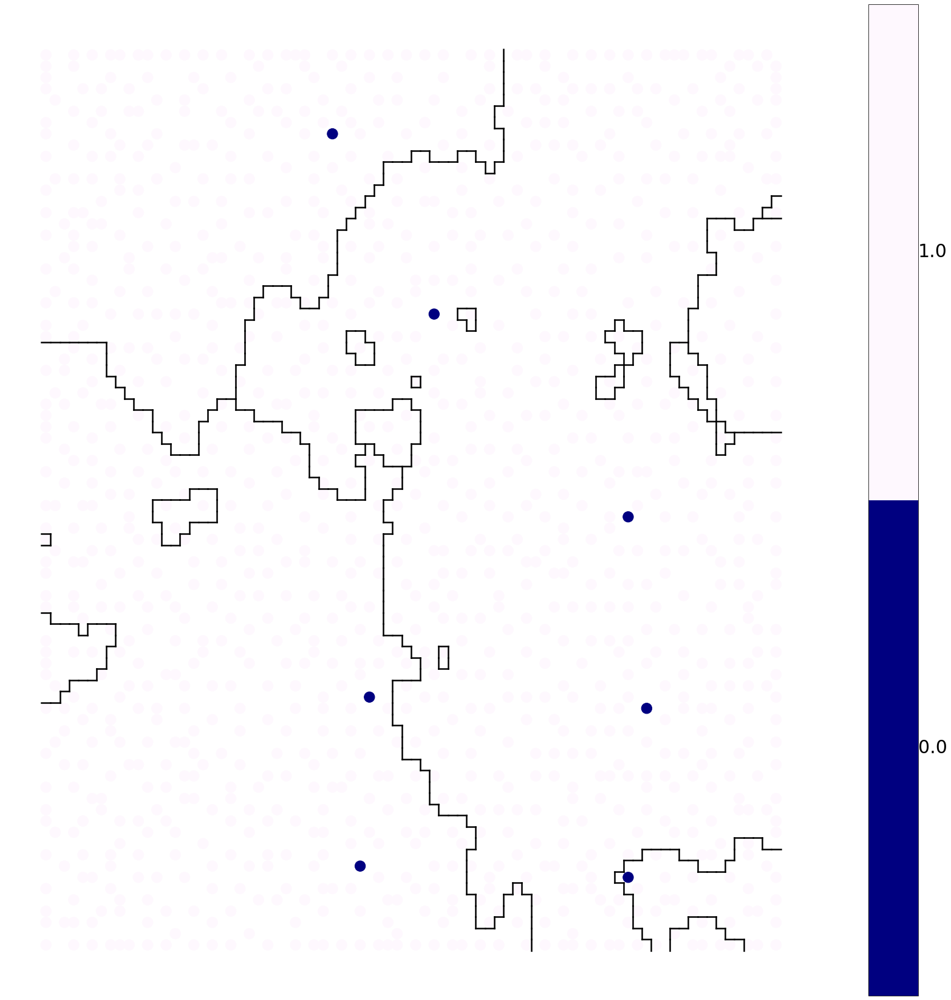

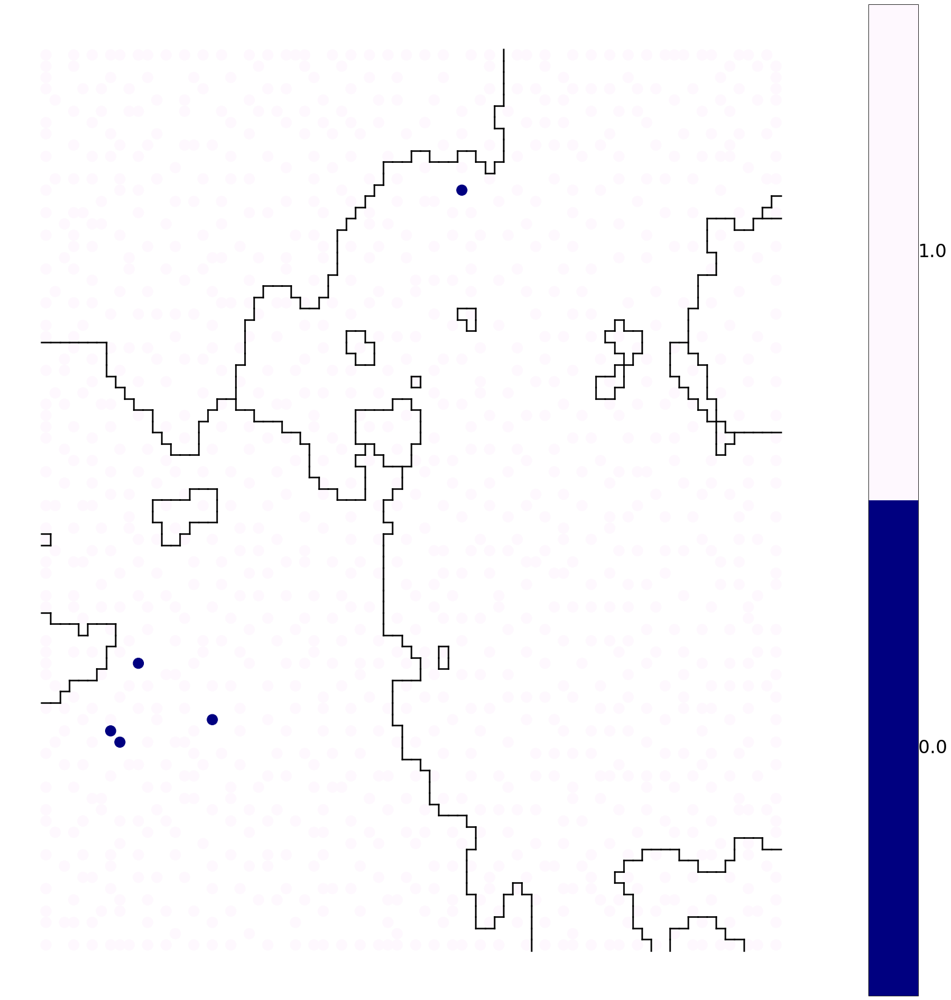

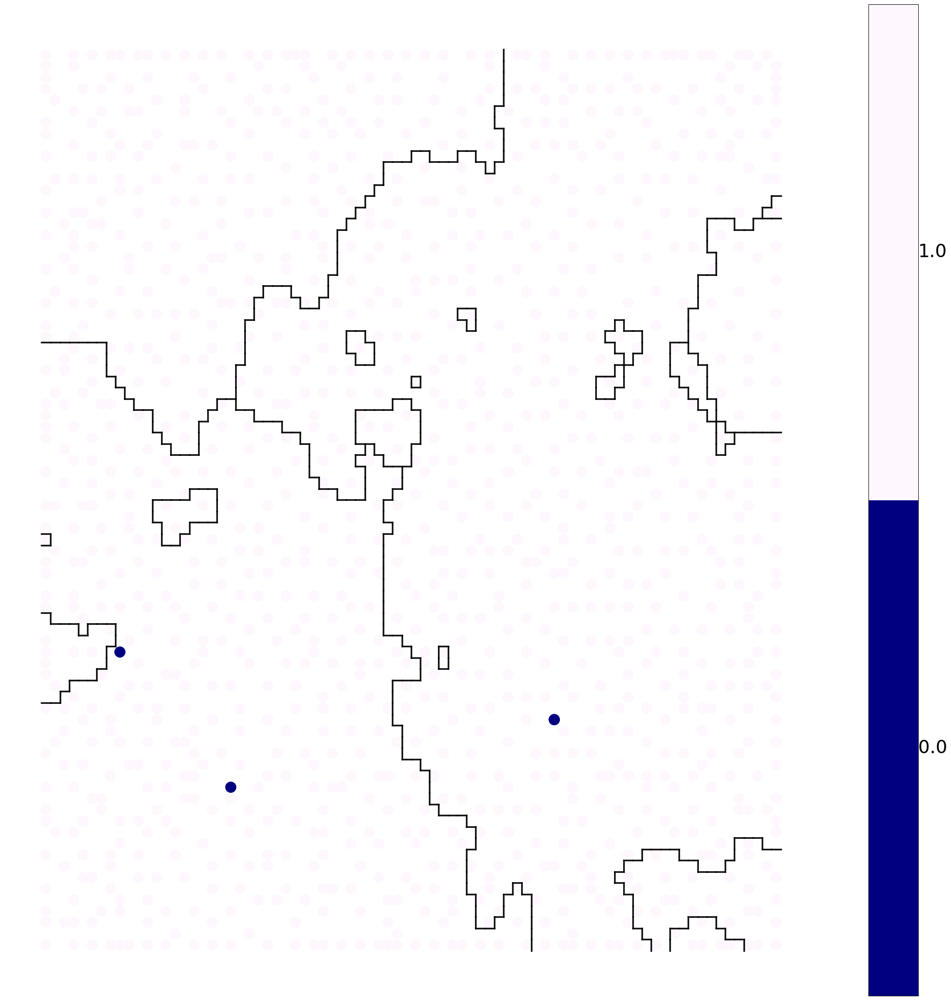

In [197]:
data['aliph_6170'] = sort_by_range(data, 61, 70, "arom_num","arom_Categ")
data['aliph_7180'] = sort_by_range(data, 71, 80, "arom_num","arom_Categ")
data['aliph_8190'] = sort_by_range(data, 81, 90, "arom_num","arom_Categ")

clusteringmap_category(sm,4,data,"aliph_6170",'./Images/descriptors/Mw_HOMO/aliph_6170.png')
clusteringmap_category(sm,4,data,"aliph_7180",'./Images/descriptors/Mw_HOMO/aliph_7180.png')
clusteringmap_category(sm,4,data,"aliph_8190",'./Images/descriptors/Mw_HOMO/aliph_8190.png')

In [200]:
# data.to_csv("./data/new_compdata_class.csv")
# data = pd.read_csv("./data/new_compdata_class.csv")
# data.head(5)

AttributeError: module 'skimage.data' has no attribute 'to_csv'

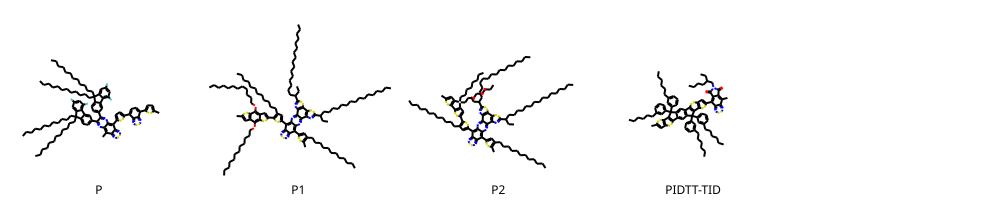

In [14]:
SMILES = [
    "CCCCCCCCCCCCC1(CCCCCCCCCCCC)c2ccc(-c3nc4c(C)c5nsnc5c(-c5ccc(-c6ccc(-c7ccc(C)s7)c7nsnc67)s5)c4nc3-c3ccc4c(c3)-c3c(F)cc(F)cc3C4(CCCCCCCCCCCC)CCCCCCCCCCCC)cc2-c2c(F)cc(F)cc21",
    "CCCCCCCCCCCCCCCCC(CC)c1nc2c3nc4c(-c5cc(CCCCCCCCCCCC)c(C)s5)c5nsnc5c(-c5cc(CCCCCCCCCCCC)c(-c6cc7c(OCCCCCCCCCCCC)c8sc(C)cc8c(OCCCCCCCCCCCC)c7s6)s5)c4nc3c3nc(C(CC)CCCCCCCCCCCCCCCC)sc3c2s1",
    "CCCCCCCCCCCCCCCCC(CC)c1nc2c3nc4c(-c5cc(CCCCCCCCCCCC)c(C)s5)c5nsnc5c(-c5cc(CCCCCCCCCCCC)c(-c6cc7c(s6)-c6sc(C)cc6[Si]7(CCCCCCCC)CCCCCCCC)s5)c4nc3c3nc(C(CC)CCCCCCCCCCCCCCCC)sc3c2s1",
    "CCCCCCc1cccc(C2(c3cccc(CCCCCC)c3)c3cc4c(cc3-c3sc5cc(C)sc5c32)C(c2cccc(CCCCCC)c2)(c2cccc(CCCCCC)c2)c2c-4sc3cc(-c4c5c(c(C)c6nsnc46)C(=O)N(CC(CC)CCCC)C5=O)sc23)c1"
]

names = [
    "P",
    "P1",
    "P2",
    "PIDTT-TID"
]

SMILES = SMILES
mol = [Chem.MolFromSmiles(x) for x in SMILES]
P = Draw.MolsToGridImage(mol,molsPerRow=5,legends=[str(y) for y in names],subImgSize=(200,200))
# s.save(fp="Images/moles/PDI",format="PNG")
P

# Molecular Structure Operation

* Extracting side chain information from SMILES
    * Including numbe of side chains, length of each chain, branch or not
* Thiophene ring (na5Ring) from 3 - 8 projection 
* Categorize branching of side chain and project on maps

The side chains of the DPP fall into three categories: linear alkyl (C8, C14, or C16), branched alkyl (ethylhexyl, EH, or hexyldecyl, HD), and linear oligo(ethylene oxide) (EO3, EO4, or EO5). Polymers bearing C8 and C14 side chains are obtained in low yields and thus not pursued. 

**Source:** Effects of flexibility and branching of side chains
on the mechanical properties of low-bandgap
conjugated polymers†
https://pubs-rsc-org.offcampus.lib.washington.edu/en/content/articlepdf/2018/py/c8py00820e

from synthetic's perspective, C16 and EO16 both have the highest yields, thus being very meaningful 

In [15]:
from __future__ import print_function
from rdkit import Chem
from rdkit.Chem.Draw import IPythonConsole
from IPython.display import SVG
from rdkit import rdBase

In [757]:
DPP = pd.read_csv("./data/DPP_df.csv")
smis = DPP['canonical_SMILES']

In [171]:
smis[5]

'CCCCCCCCCCC(CCCCCCCC)Cc1cc(-c2ccc(-c3cc(CC(CCCCCCCC)CCCCCCCCCC)c(-c4cc(F)c(-c5sc(C)cc5F)s4)s3)c3nsnc23)sc1C'

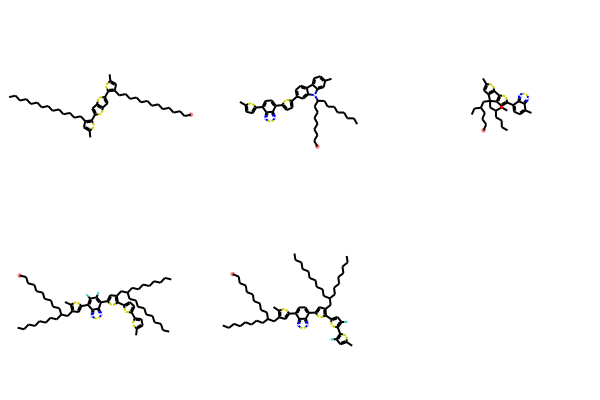

In [143]:
from rdkit import Chem
from rdkit.Chem import rdBase
from rdkit.Chem import Draw
from rdkit.Chem.Draw import IPythonConsole
from rdkit import RDConfig
import os

smis = data.CSMILES.head(5)
mols = [Chem.MolFromSmiles(x) for x in smis]
aliph = Chem.MolFromSmarts("[C]")
len(mol.GetSubstructMatch(aliph))
img = Draw.MolsToGridImage(mols, molsPerRow=3, 
                           highlightAtomLists=[mol.GetSubstructMatch(aliph)
                                               for mol in mols], useSVG=True )
img

In [291]:
mol = Chem.MolFromSmiles(SMILES)
aliph = Chem.MolFromSmarts("[C]")
len(mol.GetSubstructMatches(aliph)) # this is only a total count, not length

42

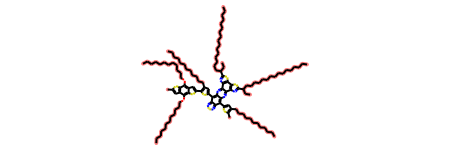

In [901]:
SMILES1 = "CCCCCCCCCCC(CCCCCCCC)Cc1cc(-c2c(F)c(F)c(-c3cc(CC(CCCCCCCC)CCCCCCCCCC)c(-c4ccc(-c5ccc(C)s5)s4)s3)c3nsnc23)sc1C"
SMILES2 = "CCCCCCCCOc1ccc(-c2nc3c(-c4ccc(C)s4)c(F)c(F)c(-c4ccc(-c5cc6c(-c7cc(F)c(CC(CC)CCCC)s7)c7sc(C)cc7c(-c7cc(F)c(CC(CC)CCCC)s7)c6s5)s4)c3nc2-c2ccc(OCCCCCCCC)cc2)cc1"
SMILES3 = "C/C=C/c1sc(/C=C/c2nc3cc4oc(C)nc4cc3o2)c(CCCCCCCCCCCC)c1CCCCCCCCCCCC"
SMILES4 = "C#CC#CC#CC#CC#CC(CCCCCCCC)CN1C(=O)c2c(C)sc(-c3cc4c(OCC(CC)CCCC)c5sc(C)cc5c(OCC(CC)CCCC)c4s3)c2C1=O.[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH]"
P1 = "CCCCCCCCCCCCCCCCC(CC)c1nc2c3nc4c(-c5cc(CCCCCCCCCCCC)c(C)s5)c5nsnc5c(-c5cc(CCCCCCCCCCCC)c(-c6cc7c(OCCCCCCCCCCCC)c8sc(C)cc8c(OCCCCCCCCCCCC)c7s6)s5)c4nc3c3nc(C(CC)CCCCCCCCCCCCCCCC)sc3c2s1"
# for SMILES4, two side chains, each 14, yet the total sum is 30, they include all aliphatic carbons insdie

mol = Chem.MolFromSmiles(P1)
aliph = Chem.MolFromSmarts("[C]")
len(mol.GetSubstructMatches(aliph)) # this is only a total count, not length
mol

In [904]:
# O, N, S, F
c1 = re.split('[0-9D-Zc-z@/-=#:]','CCCCCCCCCCC(CCCCCCCC)Cc1cc(-c2c(F)c(F)c(-c3cc(CC(CCCCCCCC)CCCCCCCCCC)c(-c4ccc(-c5ccc(C)s5)s4)s3)c3nsnc23)sc1C')
c2 = re.split('[0-9D-Zc-z@/-=#:]','CCCCC(CC)CC1(CC(CC)CCCC)c2cc(C)sc2-c2sc(-c3ccc(C)c4nsnc34)cc21')
c3 = re.split('[0-9D-Zc-z@/-=#:]','CCCCCCCCCCC(CCCCCCCC)Cc1cc(-c2ccc(-c3cc(CC(CCCCCCCC)CCCCCCCCCC)c(-c4cc(F)c(-c5sc(C)cc5F)s4)s3)c3nsnc23)sc1C')
c4 = re.split('[0-9D-Zc-z@/-=#:]',"CCCCCCCCCCCCCCCCC(CC)c1nc2c3nc4c(-c5cc(CCCCCCCCCCCC)c(C)s5)c5nsnc5c(-c5cc(CCCCCCCCCCCC)c(-c6cc7c(OCCCCCCCCCCCC)c8sc(C)cc8c(OCCCCCCCCCCCC)c7s6)s5)c4nc3c3nc(C(CC)CCCCCCCCCCCCCCCC)sc3c2s1")
c5 = re.split('[0-9D-Zc-z@/-=#:]',"CCCCCCCCCCC(CCCCCCCC)Cc1cc(-c2cc3c(cc(-c4cc(C[C@@H](CCCCCCCC)CCCCCCCCCC)c(C)s4)c4nsnc43)c3nsnc23)sc1-c1ccc(-c2ccc(C)s2)s1")
c6 = re.split('[0-9D-Zc-z@/-=#:]',"C#CC#CC#CC#CC#CC(CCCCCCCC)CN1C(=O)c2c(C)sc(-c3cc4c(OCC(CC)CCCC)c5sc(C)cc5c(OCC(CC)CCCC)c4s3)c2C1=O.[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH]")
def look_for_c(c):
    """
    Single, double, triple, and aromatic bonds are represented by the symbols -, =, #, and :, respectively. 
    """
    ls = []
    for i in range(len(c)):
        # print(c[i])
        length = ls.append(len(c[i]))
    maxi = max(ls)
    
    for i in range(len(c)):
        count = 0
        if len(c[i]) == maxi:
            count = c[i].count('C')
    return count

In [905]:
c4 # 6 side chains, 4 are branched

['CCCCCCCCCCCCCCCCC(CC)',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '(CCCCCCCCCCCC)',
 '(C)',
 '',
 ')',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '(CCCCCCCCCCCC)',
 '(-',
 '',
 '',
 '',
 '',
 '',
 '(',
 'CCCCCCCCCCCC)',
 '',
 '',
 '',
 '(C)',
 '',
 '',
 '',
 '(',
 'CCCCCCCCCCCC)',
 '',
 '',
 '',
 ')',
 '',
 ')',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '(C(CC)CCCCCCCCCCCCCCCC)',
 '',
 '',
 '',
 '',
 '',
 '',
 '']

In [906]:
c4[0].replace("(","").replace(")","") # 19 carbons, check branches
c4[0]
s = c4[15]
# read content within the parenthesis using string find() method
s[s.find("(")+1:s.find(")")]

'CCCCCCCCCCCC'

In [1284]:
# function that tells the length of side chain and whether it is branched
def chain_len_branch(smi):
    """
    :smi is the input SMILES string
    assume there is only one branch 
    """
    import re
    rule = '[0-9HRNGeSiSenrcs@/-=#:[\]{}]' # basic regex rules
    c = re.split(rule, smi)
    bls = [] # branch list
    cls = [] # chain list
    count = 0
    
    for s in c:
        # remove branching symbol '()' from remaining SMILES
        s_pro = s.replace("(","").replace(")","")
        
        if len(s_pro) > 3:
            
            # the remaining are chains with at least 3 atoms, branching or not
            # read content within the parenthesis using string find() method
            
            if "(" and ")" in s:
                
                if s.startswith(")") or s.startswith("]"):
                    s = s[1:]
                
                elif s.endswith("(") or s.endswith("["):
                    s = s[:-1]
                
                # if there are one more multiple parentheses in the segment
                pre_par = s.rfind("(") - s.find("(")
                post_par = s.rfind(")")- s.find(")")
                length = s.rfind(")") - s.find("(") - 3
                
                # (CCCCC)
                if pre_par == 0 and post_par == 0:
                    # Str = re.findall('\[[^\]]*\]|\([^\)]*\)|\"[^\"]*\"',s)
                    branch_length = len(s[s.find("(")+1:s.find(")")])
                    chain_length = len(s_pro) - branch_length
                
                # (CCCC)CC)
                elif pre_par == 0 and post_par != 0:
                    loc = s.rfind(")")
                    s = s[:loc] + s[loc+1:]
                    branch_length = len(s[s.find("(")+1:s.find(")")])
                    chain_length = len(s_pro) - branch_length
                
                # (CCCC(CC)
                elif pre_par != 0 and post_par == 0:
                    loc = s.find("(")
                    s = s[:loc] + s[loc+1:]
                    branch_length = len(s[s.find("(")+1:s.find(")")])
                    chain_length = len(s_pro) - branch_length                    
                
                else:
                    # (CCCC)(CCCC)
                    if s.rfind("(") - s.find(")") > 0:
                        # par = re.findall('\[[^\]]*\]|\([^\)]*\)|\"[^\"]*\"',s)
                        branch_length = s.find(")") - s.find("(") - 1
                        chain_length = length - branch_length
                    
                    #(CCCC(CC))
                    elif s.rfind("(") - s.find(")") < 0:
                        branch_length = s.find(")") - s.rfind("(") - 1
                        chain_length = length - branch_length
                    
            else:
                chain_length = len(s_pro)
                branch_length = 0
            
            bls.append(branch_length)
            cls.append(chain_length)
    
    return [bls, cls, len(cls)]

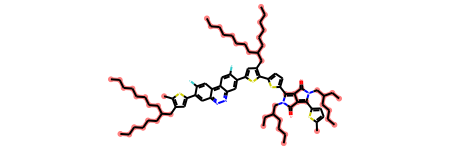

In [109]:
import re
smi = "CCCCCCCCCCCCc1cc(-c2ccc(-c3cc(CCCCCCCCCCCC)c(-c4[se]c(C)c5c4C(=O)N(C(CCCCCCCC)CCCCCCCC)C5=O)s3)s2)sc1C"
"CCCCCCCCCCCCCCCCC(CC)c1nc2c3nc4c(-c5cc(CCCCCCCCCCCC)c(C)s5)c5nsnc5c(-c5cc(CCCCCCCCCCCC)c(-c6cc7c(OCCCCCCCCCCCC)c8sc(C)cc8c(OCCCCCCCCCCCC)c7s6)s5)c4nc3c3nc(C(CC)CCCCCCCCCCCCCCCC)sc3c2s1"
SMILES1 = "CCCCCCCCCCC(CCCCCCCC)Cc1cc(-c2c(F)c(F)c(-c3cc(CC(CCCCCCCC)CCCCCCCCCC)c(-c4ccc(-c5ccc(C)s5)s4)s3)c3nsnc23)sc1C"
SMILES2 = "CCCCCCCCOc1ccc(-c2nc3c(-c4ccc(C)s4)c(F)c(F)c(-c4ccc(-c5cc6c(-c7cc(F)c(CC(CC)CCCC)s7)c7sc(C)cc7c(-c7cc(F)c(CC(CC)CCCC)s7)c6s5)s4)c3nc2-c2ccc(OCCCCCCCC)cc2)cc1"
SMILES3 = "C/C=C/c1sc(/C=C/c2nc3cc4oc(C)nc4cc3o2)c(CCCCCCCCCCCC)c1CCCCCCCCCCCC"
SMILES4 = "C#CC#CC#CC#CC#CC(CCCCCCCC)CN1C(=O)c2c(C)sc(-c3cc4c(OCC(CC)CCCC)c5sc(C)cc5c(OCC(CC)CCCC)c4s3)c2C1=O.[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH].[HH]"
P1 = "CCCCCCCCCCCCCCCCC(CC)c1nc2c3nc4c(-c5cc(CCCCCCCCCCCC)c(C)s5)c5nsnc5c(-c5cc(CCCCCCCCCCCC)c(-c6cc7c(OCCCCCCCCCCCC)c8sc(C)cc8c(OCCCCCCCCCCCC)c7s6)s5)c4nc3c3nc(C(CC)CCCCCCCCCCCCCCCC)sc3c2s1"
DPP1 = "CCCCCCCCC(CCCCCC)CS(=O)(=O)c1cc2c(C)sc(-c3cc4c(-c5ccc(CC(CC)CCCC)s5)c5sc(C)cc5c(-c5ccc(CC(CC)CCCC)s5)c4s3)c2s1"
"CCCCCCCCOc1cccc(-c2nc3c(-c4ccc(C)s4)ccc(-c4ccc(-c5ccc(-c6c7cc(OCCCCCCCC)c(OCCCCCCCC)cc7c(-c7ccc(C)cc7)c7cc(OCCCCCCCC)c(OCCCCCCCC)cc67)cc5)s4)c3nc2-c2cccc(OCCCCCCCC)c2)c1"
"CCCCC(CC)Cc1cc(C)sc1-c1nc2sc(-c3sc(-c4ccc5c(c4)[Si](CC(CC)CCCC)(CC(CC)CCCC)c4cc(C)ccc4-5)cc3C[C@H](CC)CCCC)nc2s1"
"CCCCCCC(CCCC)CCc1c2cc(-c3sc(-c4c(F)c(F)c(-c5cc(C[C@H](CC)CCCC)c(C)s5)c5nsnc45)cc3CC(CC)CCCC)sc2c(CC[C@@H](CCCC)CCCCCC)c2cc(C)sc12"
"CCCCCCCCN1C(=O)C2=C(c3ccc(-c4ccc5c(c4)[Ge](CCCCCCCC)(CCCCCCCC)c4cc(C)ccc4-5)s3)N(CCCCCCCC)C(=O)C2=C1c1ccc(C)s1"
second = "CCCCCCCCC(CCCCCC)Cc1cc(-c2cc3nnc4cc(-c5cc(CC(CCCCCC)CCCCCCCC)c(-c6ccc(C7=C8C(=O)N(CC(CC)CCCC)C(c9ccc(C)s9)=C8C(=O)N7CC(CC)CCCC)s6)s5)c(F)cc4c3cc2F)sc1C"

"CCCCCCCCC(CCCCCCCC)n1c2cc(C)ccc2c2ccc(-c3ccc(-c4ccc(-c5ccc(C)s5)c5nsnc45)s3)cc21"
"CCCCCCCCN1C(=O)C2=C(c3ccc(-c4ccc5c(c4)[Ge](CCCCCCCC)(CCCCCCCC)c4cc(C)ccc4-5)s3)N(CCCCCCCC)C(=O)C2=C1c1ccc(C)s1"
"CCCCC(CC)CC(C[C@H](CC)CCCC)n1c2cc(C)sc2c2sc(-c3ccc(C4=C5C(=O)N(C[C@H](CC)CCCC)C(c6ccc(C)s6)=C5C(=O)N4C[C@H](CC)CCCC)s3)cc21"
"CCCCC(CC)CC(C[C@H](CC)CCCC)n1c2cc(C)sc2c2sc(-c3ccc(C4=C5C(=O)N(C[C@H](CC)CCCC)C(c6ccc(C)s6)=C5C(=O)N4C[C@H](CC)CCCC)s3)cc21"
"CCCCCCCCN1C(=O)C2=C(c3ccc(-c4ccc5c(c4)[Ge](CCCCCCCC)(CCCCCCCC)c4cc(C)ccc4-5)s3)N(CCCCCCCC)C(=O)C2=C1c1ccc(C)s1"

c7 = re.split('[0-9HRNGeSiSenrcs@/-=#:[\]{}]',second)
mol = Chem.MolFromSmiles(second)
aliph = Chem.MolFromSmarts("[C]")
len(mol.GetSubstructMatches(aliph)) # this is only a total count, not length
mol

In [1291]:
chain_len_branch(DPP1)

[[0, 9, 9, 9, 9, 9], [9, 0, 0, 0, 0, 0], 6]

In [1274]:
re.split('[0-9HRNGeSiSenrcs@/-=#:[\]{}]',DPP1)

['CCCCCCCCO',
 '',
 '',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '',
 '(C)',
 '',
 ')',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '',
 '',
 '(OCCCCCCCC)',
 '(OCCCCCCCC)',
 '',
 '',
 '',
 '(-',
 '',
 '',
 '',
 '',
 '(C)',
 '',
 '',
 ')',
 '',
 '',
 '',
 '(OCCCCCCCC)',
 '(OCCCCCCCC)',
 '',
 '',
 '',
 ')',
 '',
 '',
 ')',
 '',
 ')',
 '',
 '',
 '',
 '',
 '-',
 '',
 '',
 '',
 '',
 '',
 '(OCCCCCCCC)',
 '',
 ')',
 '',
 '']

In [1115]:
s = "(CC)CCC)"
"(CCCCCCCC)(CCCCCCCC)"
"(CC)CCC)" # what if there are multiple parenthesis in a string?
"(CCCC(CC)"

l = len(s[s.find("(")+1:s.find(")")]) # ends with )
l
r = len(s.replace("(","").replace(")","")) - l
l

# re.search
Str = "Hello (Test1 test2) (Hello1 hello2) other_stuff"
re.search(r'\((.*?)\)',Str).group(0)

# 2 pars
par = re.findall('\[[^\]]*\]|\([^\)]*\)|\"[^\"]*\"',s)
# l = len(par[par.find("(")+1:par.find(")")])

pre_par = s.rfind("(") - s.find("(")
post_par = s.rfind(")")- s.find(")")
length = s.rfind(")") - s.find("(") - 3

loc = s.rfind(")")
# s = s[:loc] + s[loc+1:]
par = re.findall('\[[^\]]*\]|\([^\)]*\)|\"[^\"]*\"',s)
len(s[s.find("(")+1:s.find(")")])

s = "(CCCC)(CCCCC)"
branch_length = s.find(")") - s.find("(") - 1
chain_length = length - branch_length

branch_length
length = s.rfind(")") - s.find("(") - 3

s = "(CC)CCC(CC)"
par = re.findall('\[[^\]]*\]|\([^\)]*\)|\"[^\"]*\"',s)
par[0]

'(CC)'

In [350]:
c4[0]
ls = []
for s in c7:
    s_pro = s.replace("(","").replace(")","")
    if len(s_pro) > 2:
        print(s)
        ls.append(len(s_pro))
print(ls)

(CCCCCCCCCCCC)
CCCCCCCCCCCC
[12, 12]


In [736]:
a = chain_len_branch(SMILES1)

In [1330]:
def SMILES_len_branch(smis):
    """
    For the entire dataset
    """
    
    # smis = data.CSMILES # use the canonical SMILES
    ls = []
    for smi in smis:
        ls.append(chain_len_branch(smi))
    return ls

In [1331]:
smis = data.CSMILES
# chain1 and chain2, whichever is longer is the chain, short one is the branch
chain_branch_length = pd.DataFrame(SMILES_len_branch(smis),columns=['chain1','chain2','number_chains'])

In [1332]:
chain_df = chain_branch_length.set_index(data['ID No.'])

In [1337]:
chain_df['chain1'][1][0]

0

In [1203]:
# data['chain1'] = chain_branch_length['chain1'].set_index(data['ID No.'])
# data['chain2'] = chain_branch_length['chain2'].set_index(data['ID No.'])
# data['number_chains'] = chain_branch_length['number_chains'].set_index(data['ID No.'])
# data.to_csv("./data/new_compdata_class2.csv")
# data = pd.read_csv("./data/new_compdata_class2.csv")
# data.head(5)

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\IPython\core\interactiveshell.py:3044: DtypeWarning: Columns (42,43,44,45,46,47,48,49,50,51,52,53,91,92,93,94,95,96,97,98,99,190,191,192,193,194,195,196,197,198,298,299,300,301,302,303,304,305,306,406,407,408,409,410,411,412,413,414,511,512,513,514,515,516,517,518,607,608,609,610,611,612,613,614,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,853,861,869,877,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,1086,1087,1088,1089,1090

,ID No.,Unnamed: 0,Nickname,Ref. No,PCE_max,PCE_ave,Voc (V),Jsc (mA/cm2),FF,Mw (kg/mol),...,number_chains,naRingbychain,arombychain,aliphbychain,number_chains_Categ,arombychain_Categ,aliphbychain_Categ,naRingbychain_Categ,numchain3,numchain4
0,1,0,PBTTT-C14,S1,2.34,2.34,0.53,9.37,0.48,46.2,...,1.0,2.0,7.0,15.0,1.0,1.0,2.0,1.0,1.0,1.0
1,2,1,PCDTBT,S2,3.60,3.60,0.89,6.92,0.63,73.0,...,2.0,7.0,26.0,19.0,1.0,4.0,3.0,4.0,1.0,1.0
2,3,2,PCPDTBT,S3,5.12,5.12,0.61,15.73,0.53,47.6,...,2.0,2.0,7.0,9.5,1.0,1.0,1.0,1.0,1.0,1.0
3,4,3,PffBT4T-2OD,S4,10.50,10.20,0.77,18.40,0.74,93.7,...,2.0,3.0,11.0,21.0,1.0,2.0,3.0,2.0,1.0,1.0
4,5,4,PffBT4T-2OD,S4,10.40,10.00,0.77,18.20,0.74,52.9,...,2.0,3.0,11.0,21.0,1.0,2.0,3.0,2.0,1.0,1.0


### Read chain1, chain2 and number of chains

* tell number of alkyl chains
* tell length of each chain, main and branch

**3 suggestions from Professor Saeki**

1. number of alkyl chains
2. shape (branched or linear)
3. number of aromatics / number of chains

In [1204]:
chain1 = data['chain1']
chain2 = data['chain2']
number_chains = data['number_chains'] # 1 - 8
# max(number_chains)
# min(number_chains)

In [1433]:
data = pd.read_csv("./data/new_compdata_class.csv")
# data.head(5)
# data['naRingbychain'] = data['naRing'] / data['number_chains']
# data['arombychain'] = data['arom_num'] / data['number_chains']
# data['aliphbychain'] = data['aliph_num'] / data['number_chains']

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\IPython\core\interactiveshell.py:3044: DtypeWarning: Columns (41,42,43,44,45,46,47,48,49,50,51,52,90,91,92,93,94,95,96,97,98,189,190,191,192,193,194,195,196,197,297,298,299,300,301,302,303,304,305,405,406,407,408,409,410,411,412,413,510,511,512,513,514,515,516,517,606,607,608,609,610,611,612,613,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,852,860,868,876,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,1085,1086,1087,1088,1089

In [1435]:
data['naRingbyChain']

0        2
1        7
2        2
3        3
4        3
5        3
6        3
7        4
8        1
9        2
10       4
11       2
12       4
13       1
14       2
15       2
16       2
17       2
18       2
19       2
20       1
21       2
22       2
23       2
24       3
25       4
26       5
27       2
28       2
29       4
30       7
31       7
32       7
33       7
34       7
35       7
36       7
37       7
38       2
39       7
40       7
41       9
42       3
43       3
44       4
45       4
46       4
47       5
48       6
49       1
50       1
51       1
52       1
53       1
54       3
55       1
56       1
57       1
58       1
59       1
60       1
61       1
62       1
63       3
64       4
65       2
66       1
67       1
68       1
69       2
70       1
71       1
72       1
73       1
74       1
75       1
76       1
77       2
78       1
79       3
80       2
81       2
82       2
83       1
84       1
85       2
86       2
87       2
88       2
89       2
90       2

locator: <matplotlib.ticker.FixedLocator object at 0x00000277C013F9B0>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

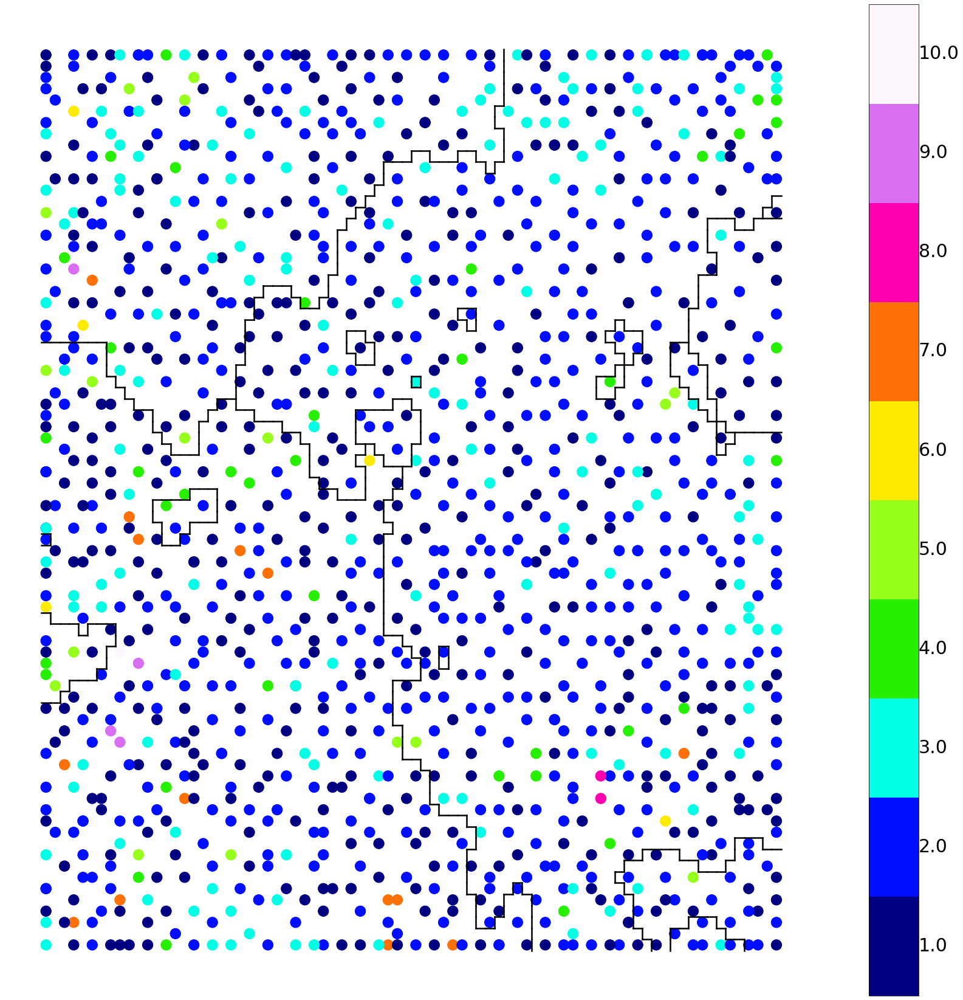

In [1439]:
data["naRingbyChain_Categ"] = classify_by_group(data,"naRingbyChain",10)
clusteringmap_category(sm,4,data,"naRingbyChain_Categ",'./Images/descriptors/Mw_HOMO/naRingbyChain_Categ.png')

locator: <matplotlib.ticker.FixedLocator object at 0x00000277AFCD98D0>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x00000277B0020A58>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x00000277B1471978>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

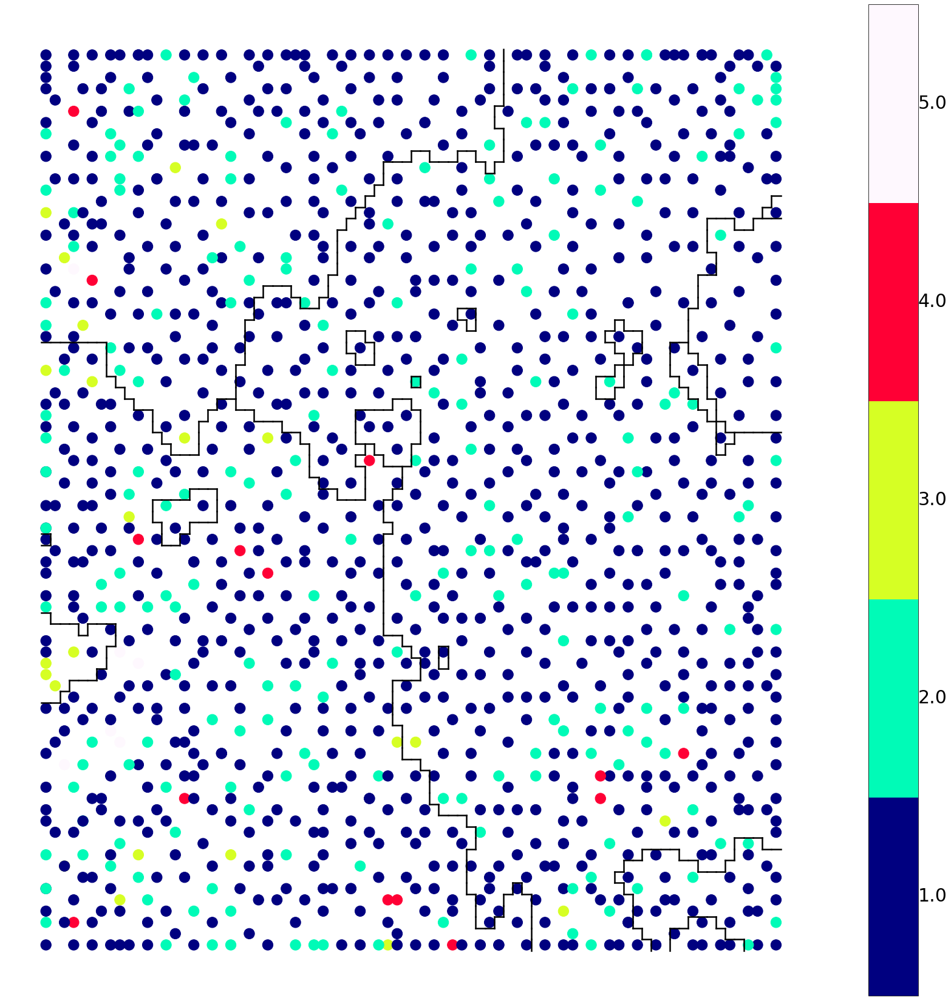

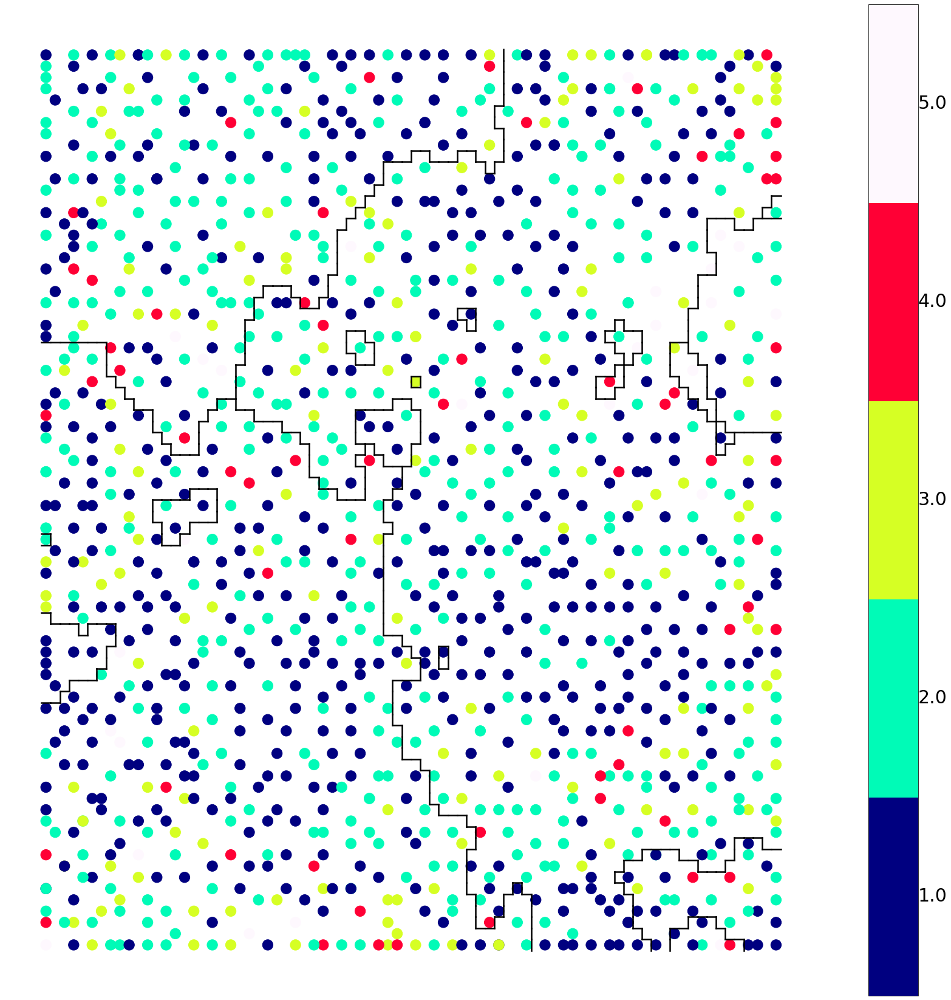

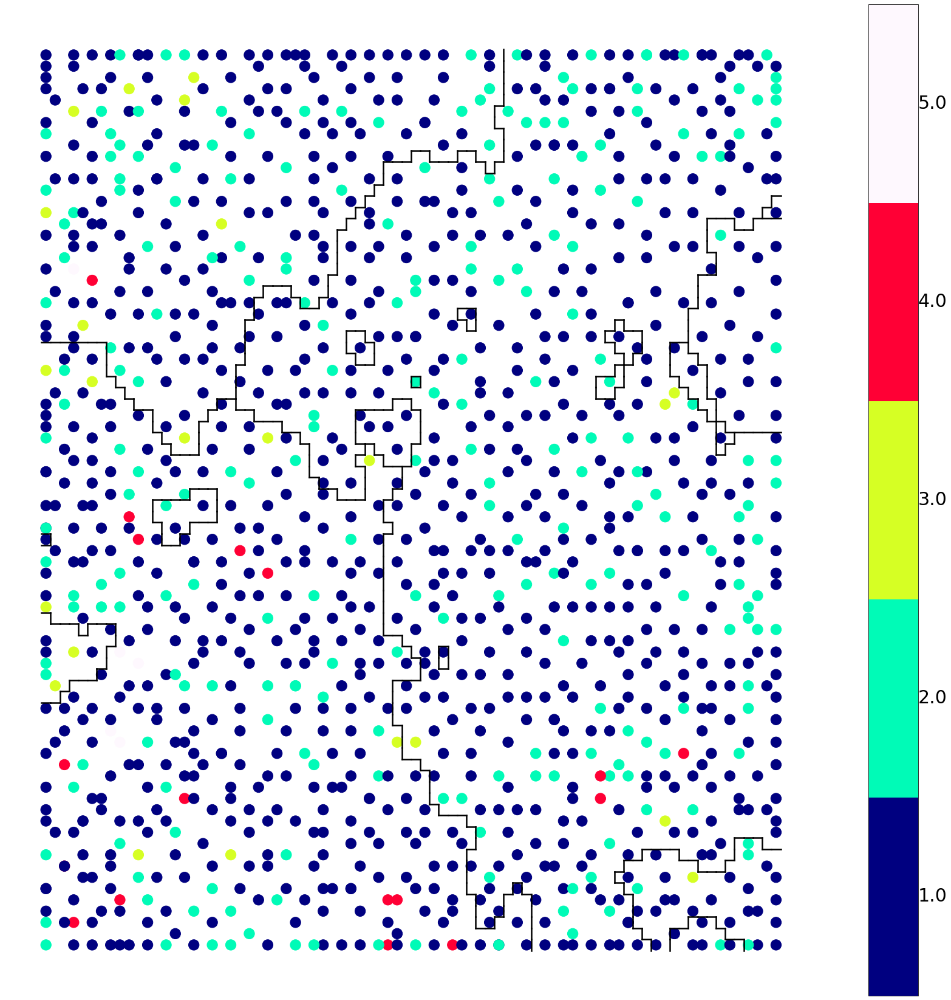

In [1167]:
data["number_chains_Categ"] = classify_by_group(data,"number_chains",5)
data["arombychain_Categ"] = classify_by_group(data,"arombychain",5)
data["aliphbychain_Categ"] = classify_by_group(data,"aliphbychain",5)
data["naRingbychain_Categ"] = classify_by_group(data,"naRingbychain",5)

clusteringmap_category(sm,4,data,"arombychain_Categ",'./Images/descriptors/Mw_HOMO/arombychain_Categ.png')
clusteringmap_category(sm,4,data,"aliphbychain_Categ",'./Images/descriptors/Mw_HOMO/aliphbychain_Categ.png')
clusteringmap_category(sm,4,data,"naRingbychain_Categ",'./Images/descriptors/Mw_HOMO/naRingbychain_Categ.png')

locator: <matplotlib.ticker.FixedLocator object at 0x000002779EA9D748>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

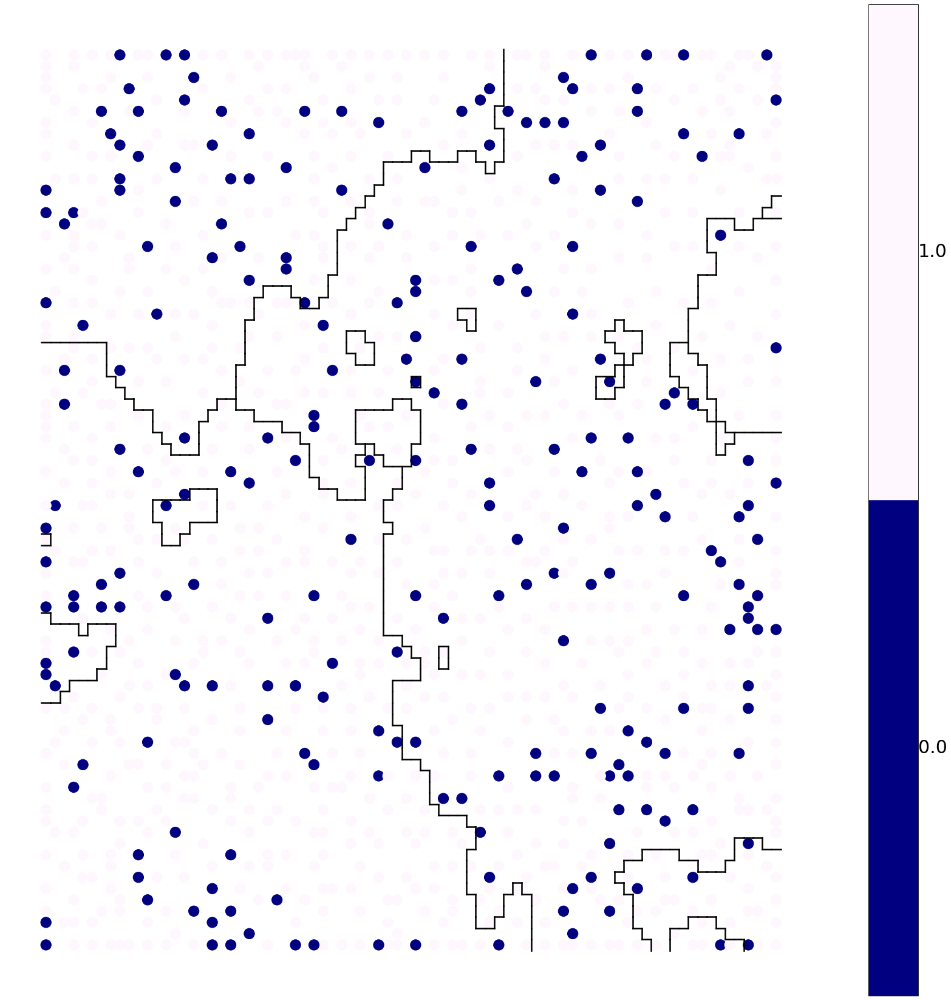

In [1083]:
data["naRingbychain_23"] = sort_by_range(data, 2.0,3.0,"naRingbychain_Categ","naRingbychain_Categ")
clusteringmap_category(sm,4,data,"naRingbychain_23",'./Images/descriptors/Mw_HOMO/naRingbychain_23.png')

locator: <matplotlib.ticker.FixedLocator object at 0x00000277A6997898>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

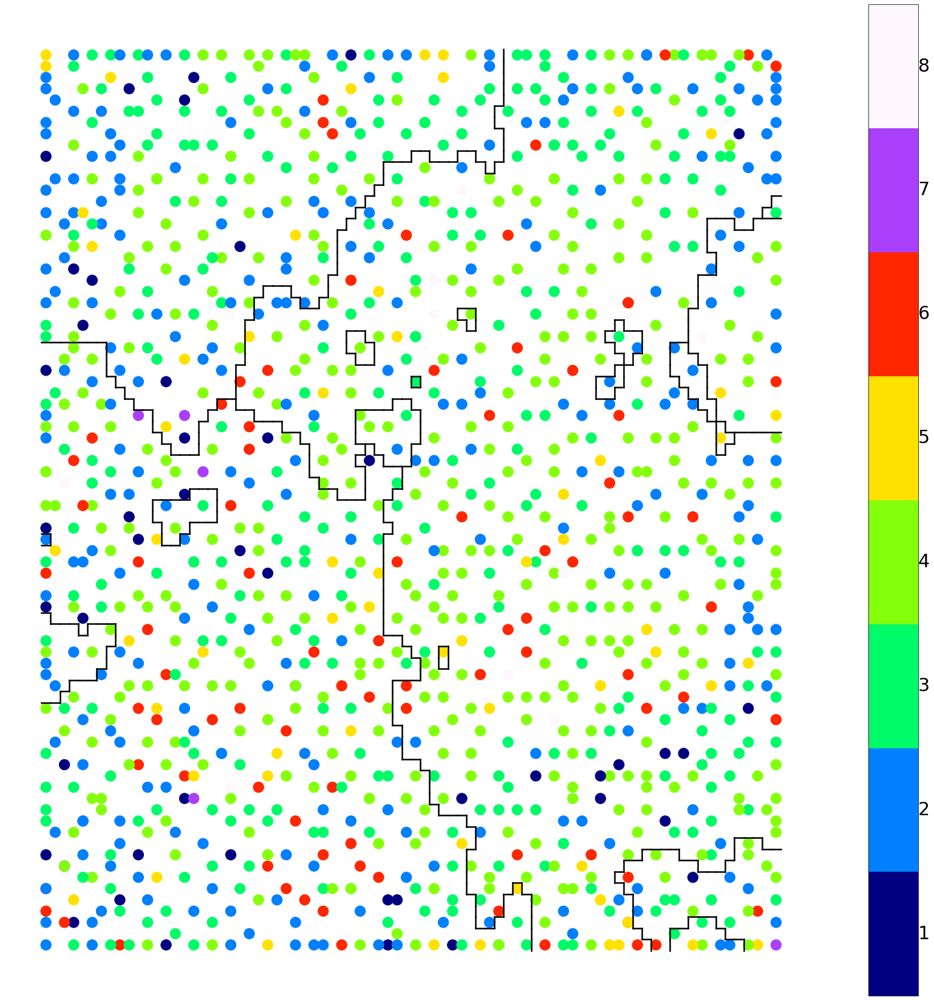

In [1176]:
# number of chains 1-8
# 1-2 3-4 5-6 7-8
data["number_chains_Categ"] = classify_by_group(data,"number_chains",4)
clusteringmap_category(sm,4,data,"number_chains",'./Images/descriptors/Mw_HOMO/number_chains.png')

In [1174]:
data['numchain3'] = sort_by_range(data,3,3,"number_chains","number_chains_Categ")
data['numchain4'] = sort_by_range(data,4,4,"number_chains","number_chains_Categ")

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\pandas\core\indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


locator: <matplotlib.ticker.FixedLocator object at 0x000002779DF167B8>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x0000027792265CF8>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

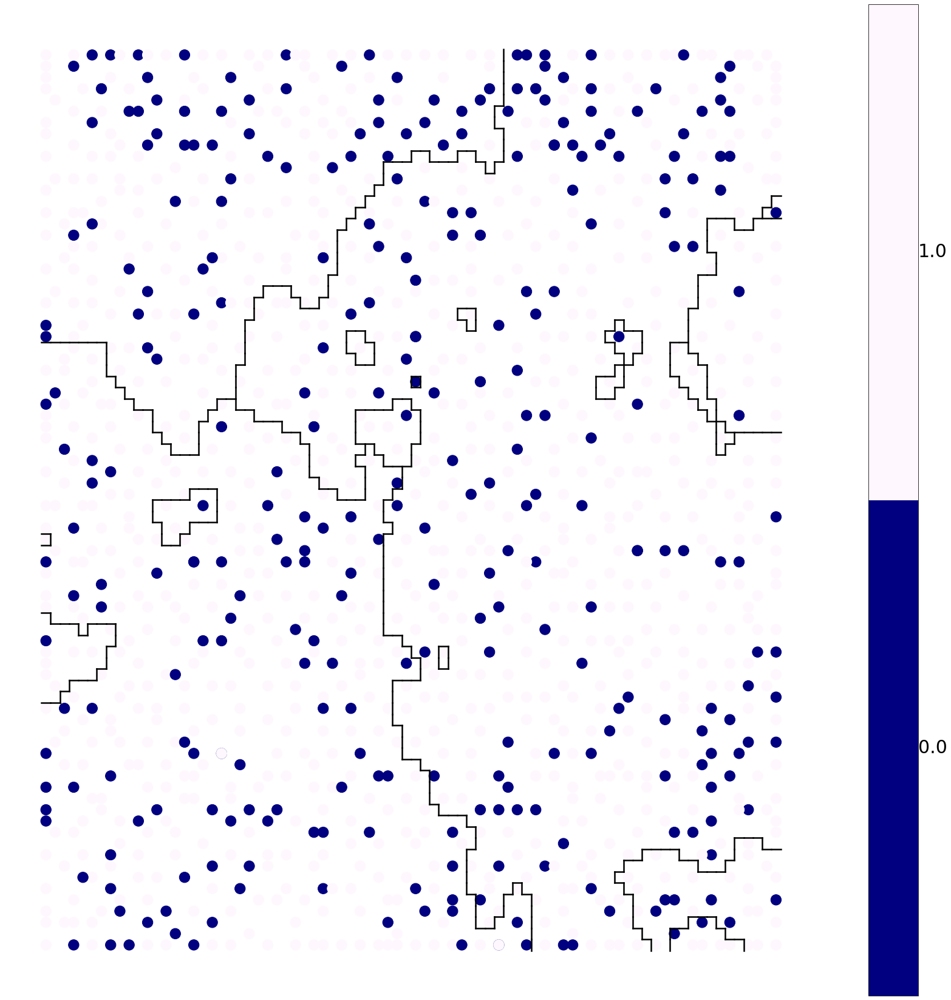

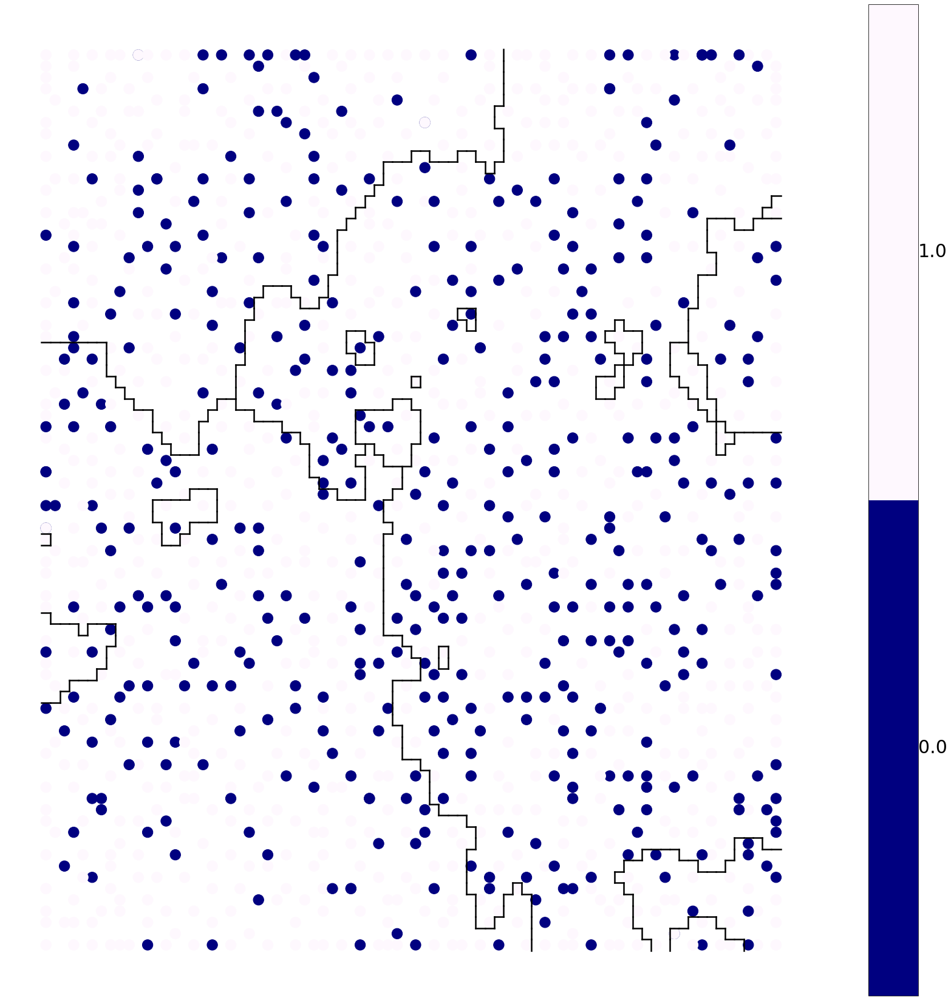

In [1175]:
clusteringmap_category(sm,4,data,"numchain3",'./Images/descriptors/Mw_HOMO/numchain3.png')
clusteringmap_category(sm,4,data,"numchain4",'./Images/descriptors/Mw_HOMO/numchain4.png')

locator: <matplotlib.ticker.FixedLocator object at 0x00000277A79D4B00>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

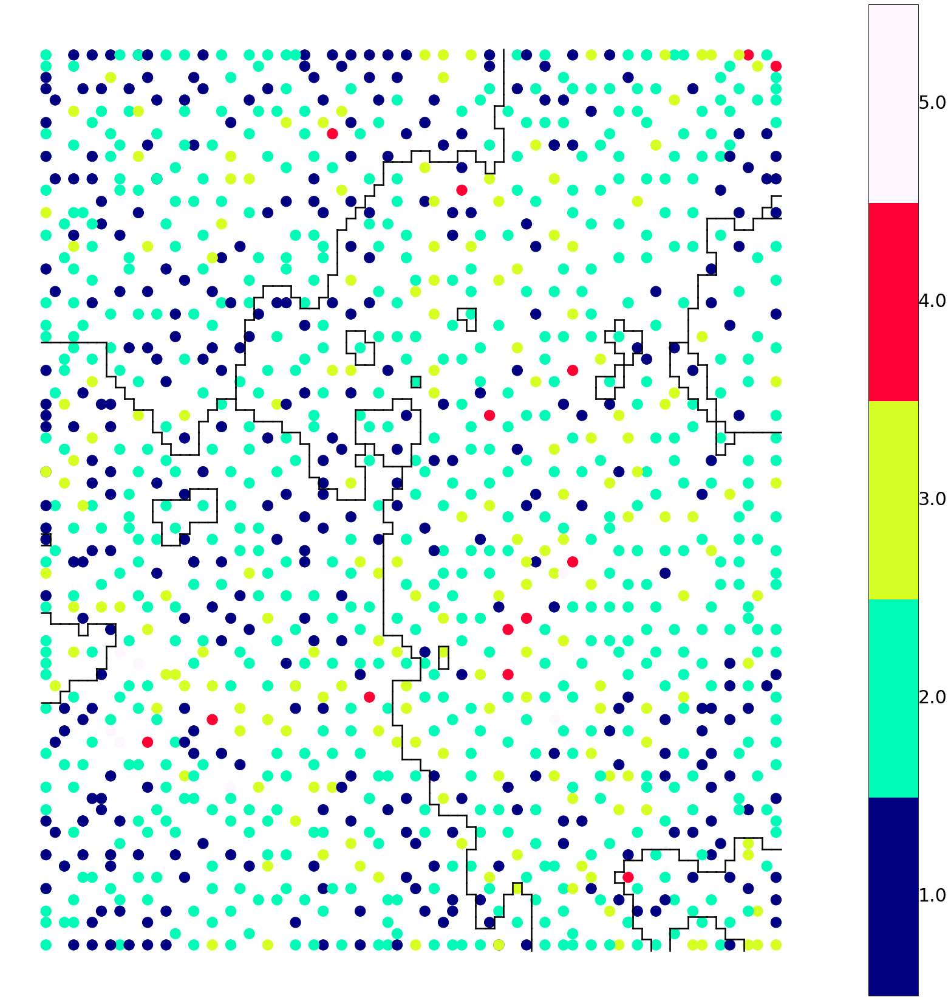

In [1099]:
# naRing 1-21
# data['naRing3'] = sort_by_range(data,3,3,"number_chains","number_chains_Categ")
# data['naRing4'] = sort_by_range(data,4,4,"number_chains","number_chains_Categ")

data["naRing_Categ"] = classify_by_group(data,"naRing",5)
clusteringmap_category(sm,4,data,"naRing_Categ",'./Images/descriptors/Mw_HOMO/naRing_Categ.png')

### Side chain length and branch projection

In [114]:
# starting from ID number 1
data = pd.read_csv("./data/new_compdata_class.csv")
chain_df = pd.read_csv("./data/chain_df.csv")

chain1 = data.chain1
chain2 = data.chain2

chain1_ls = list(data.chain1)
chain2_ls = list(data.chain1)

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\IPython\core\interactiveshell.py:3044: DtypeWarning: Columns (41,42,43,44,45,46,47,48,49,50,51,52,99,100,101,102,103,104,105,106,107,198,199,200,201,202,203,204,205,206,306,307,308,309,310,311,312,313,314,414,415,416,417,418,419,420,421,422,519,520,521,522,523,524,525,526,615,616,617,618,619,620,621,622,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,861,869,877,885,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,1094,1095,1096,1

In [76]:
chain1 = data['chain1']
chain2 = data['chain2']

'0'

In [69]:
l = [chain.strip() for chain in chain1[0].split(',')]

In [87]:
chain1[0].strip()

'[0, 14]'

each extracted instance is a string instead of a list, we would convert it to a list and perform projection

### Thiophene Rings (4-9)

In [129]:
data = pd.read_csv("./data/new_compdata_class.csv").set_index("ID No.")

# data['n5aRing45'] = sort_by_range(data, 4, 5, "n5aRing","n5aRing_Categ5")
# data['n5aRing67'] = sort_by_range(data, 6, 7, "n5aRing","n5aRing_Categ5")
# data['n5aRing89'] = sort_by_range(data, 8, 9, "n5aRing","n5aRing_Categ5")

C:\Users\jtz93\Anaconda3\envs\SOMenv\lib\site-packages\IPython\core\interactiveshell.py:3044: DtypeWarning: Columns (41,42,43,44,45,46,47,48,49,50,51,52,99,100,101,102,103,104,105,106,107,198,199,200,201,202,203,204,205,206,306,307,308,309,310,311,312,313,314,414,415,416,417,418,419,420,421,422,519,520,521,522,523,524,525,526,615,616,617,618,619,620,621,622,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,861,869,877,885,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,1094,1095,1096,1

locator: <matplotlib.ticker.FixedLocator object at 0x000002172B709978>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x00000217251B6C50>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000002172B9A9F28>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

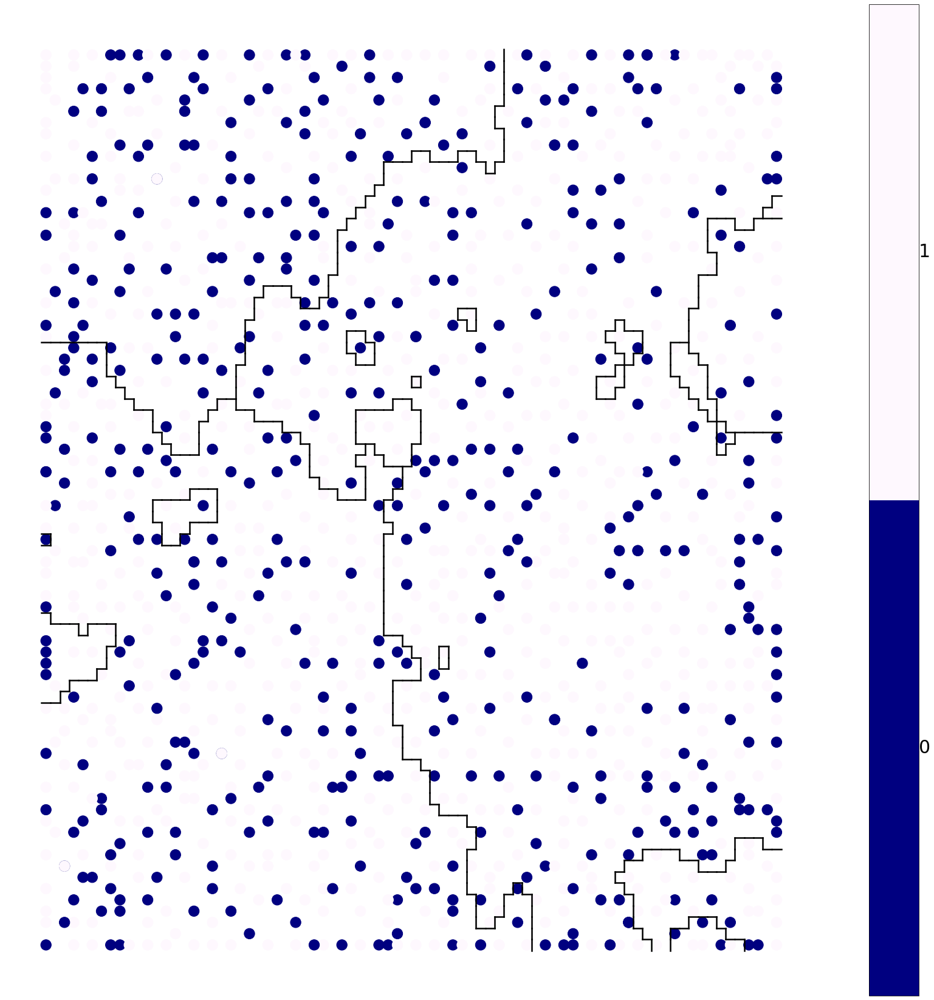

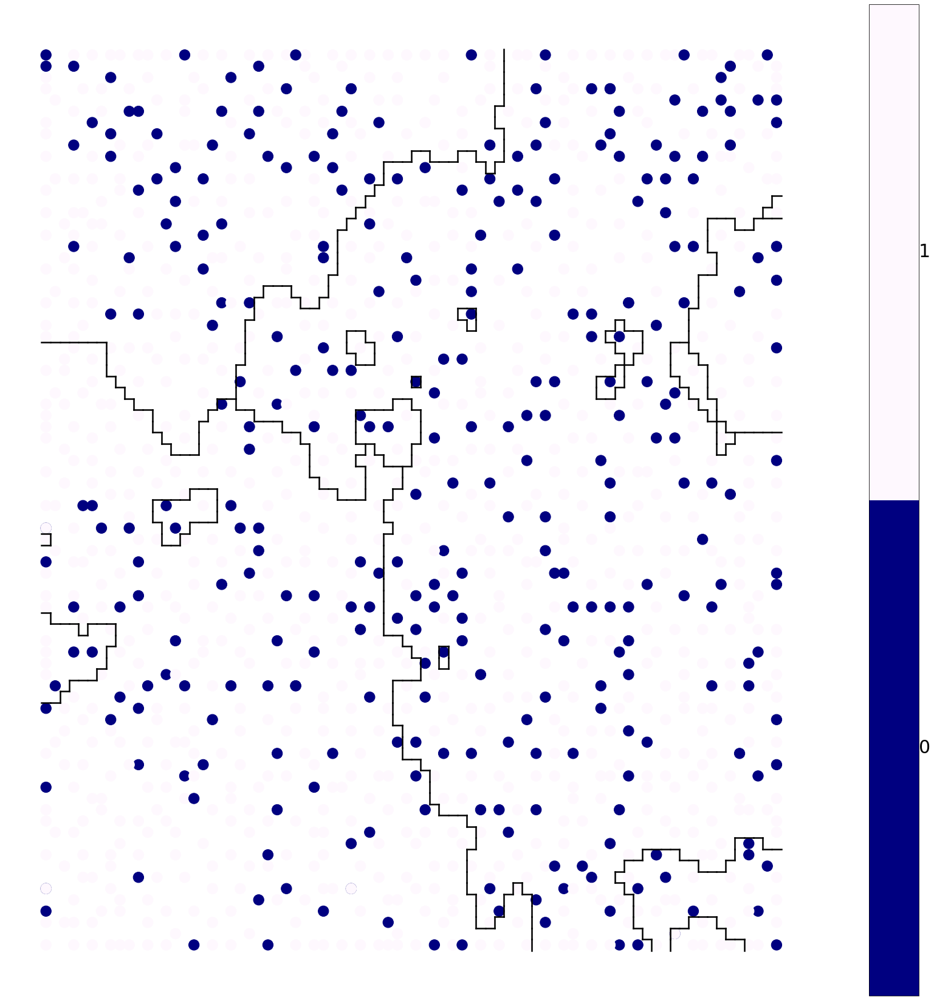

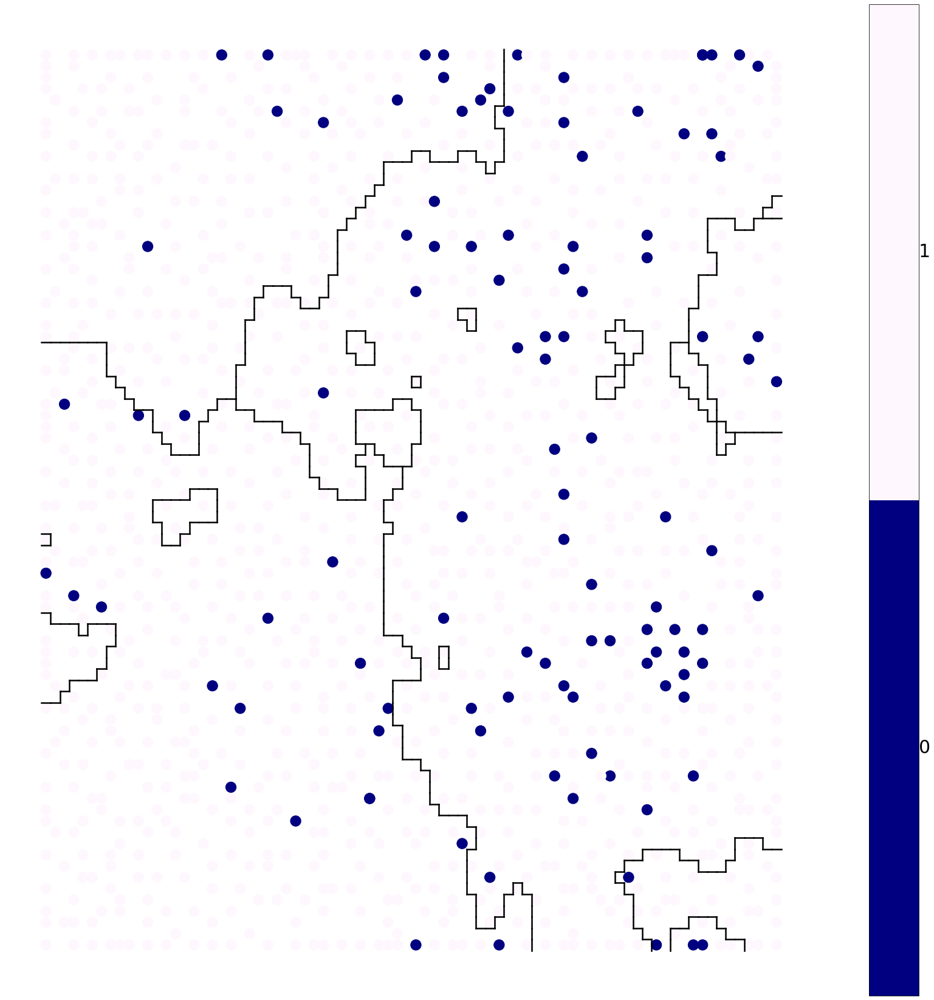

In [130]:
clusteringmap_category(sm,4,data,"n5aRing_Categ=45",'./Images/descriptors/Mw_HOMO/n5aRing45.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=67",'./Images/descriptors/Mw_HOMO/n5aRing67.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=89",'./Images/descriptors/Mw_HOMO/n5aRing89.png')

locator: <matplotlib.ticker.FixedLocator object at 0x000002172E543E48>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x00000217292EB8D0>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000002172A7AEC18>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x000002172D954F60>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x0000021732EC1B38>
Using fixed locator on colorbar
Setting pcolormesh
locator: <matplotlib.ticker.FixedLocator object at 0x00000217338C8DA0>
Using fixed locator on colorbar
Setting pcolormesh


array([0, 0, 0, ..., 2, 2, 2])

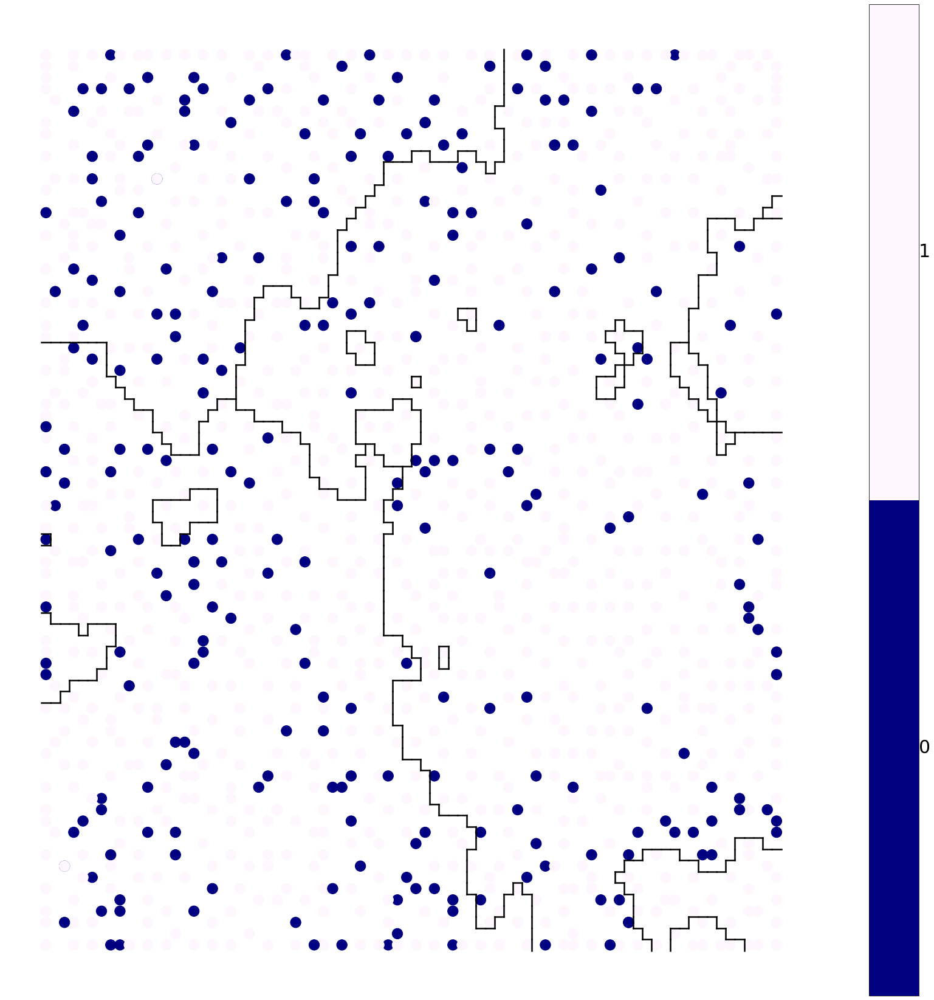

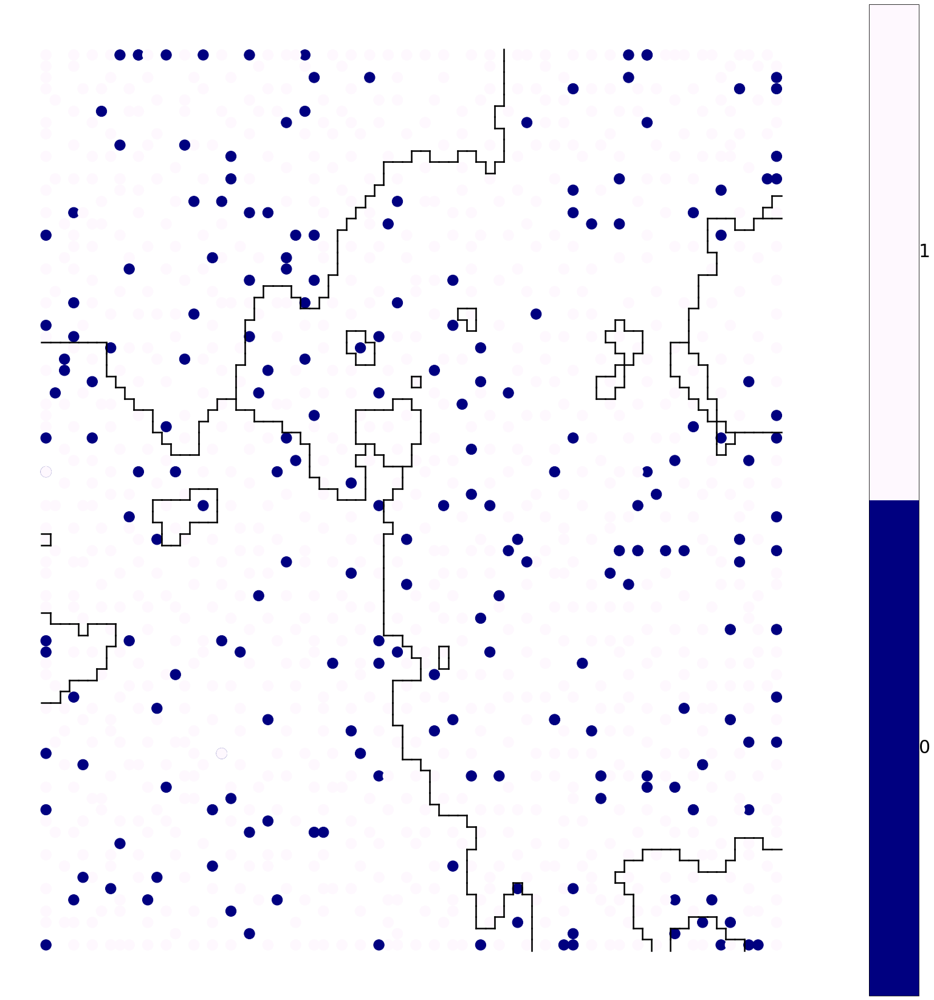

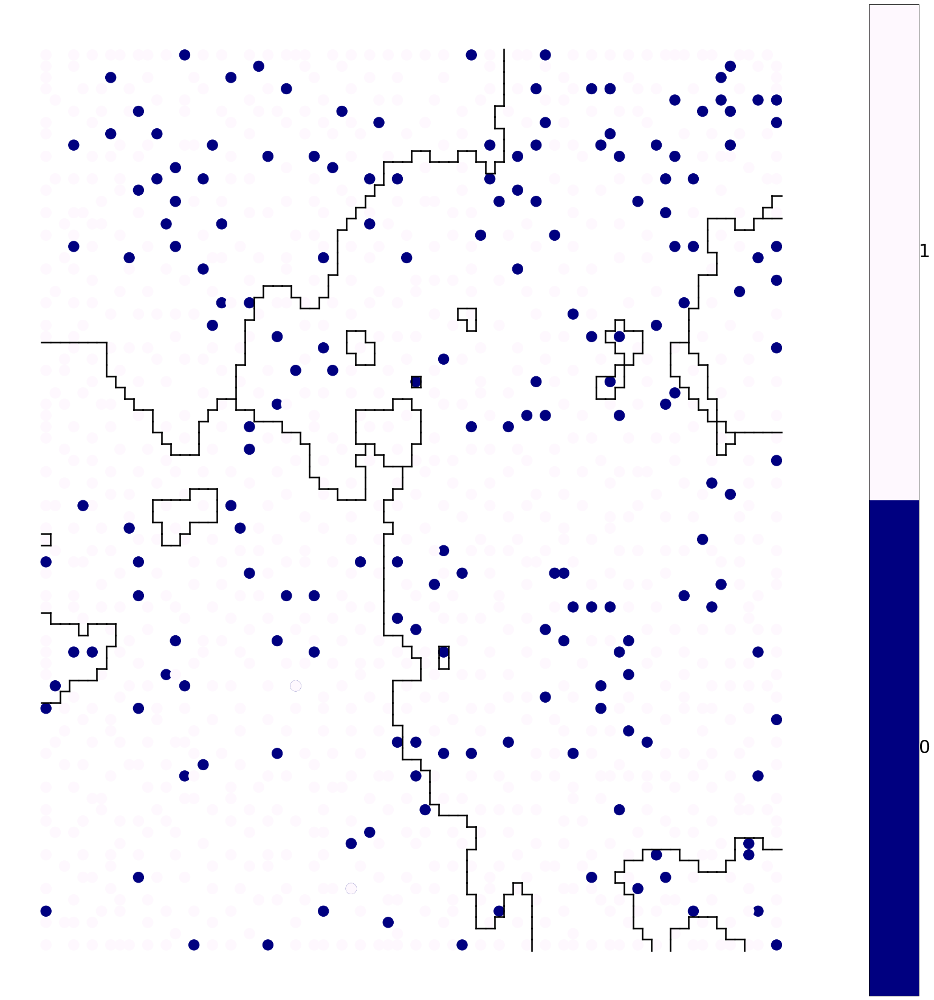

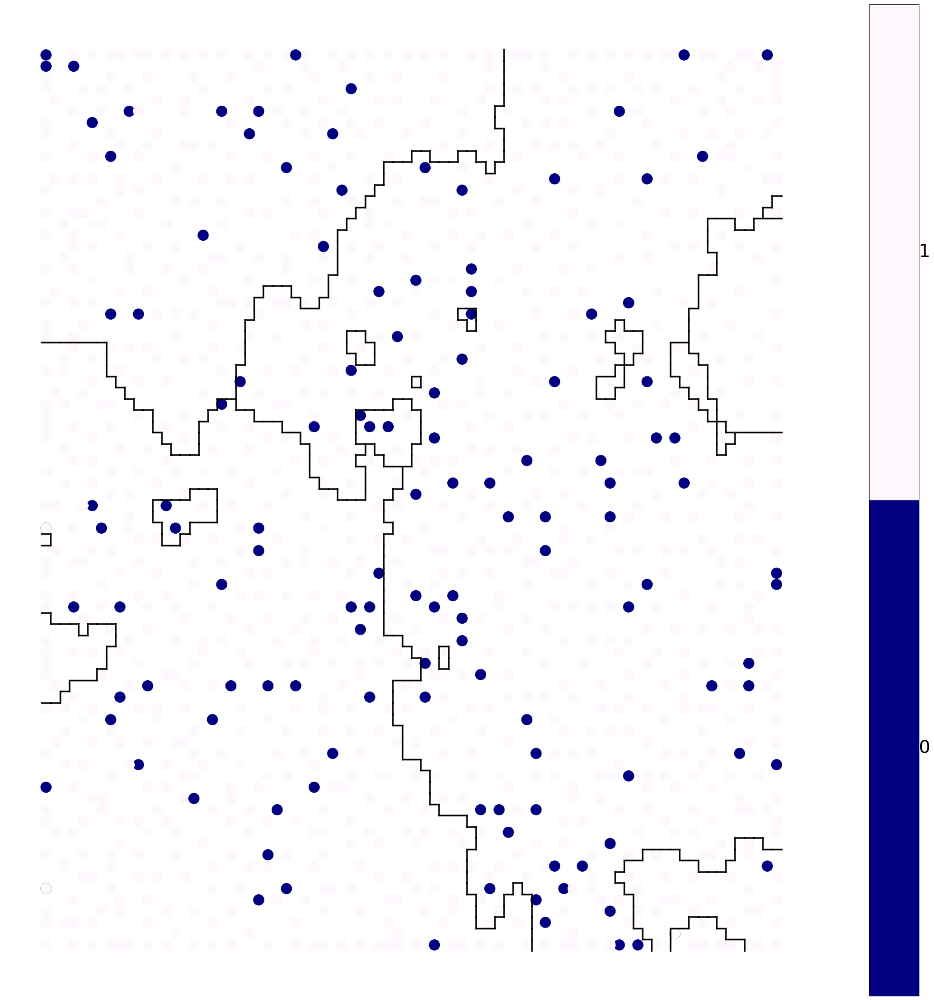

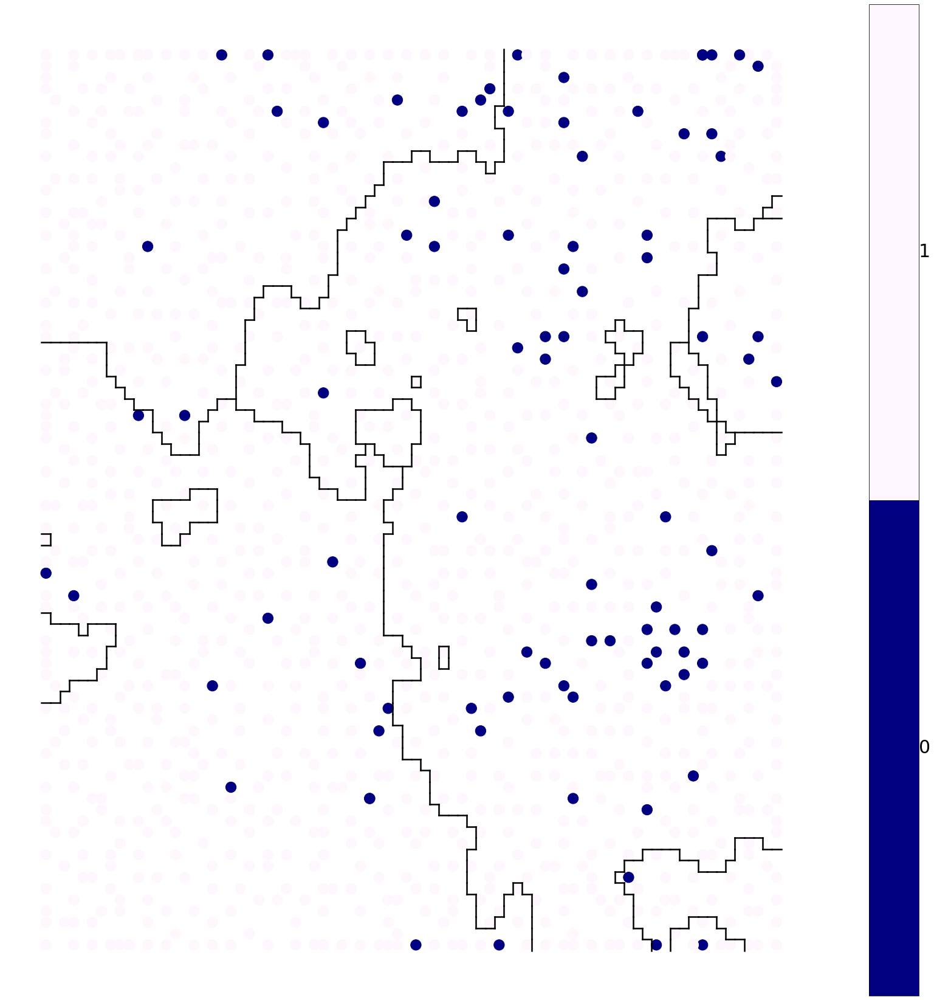

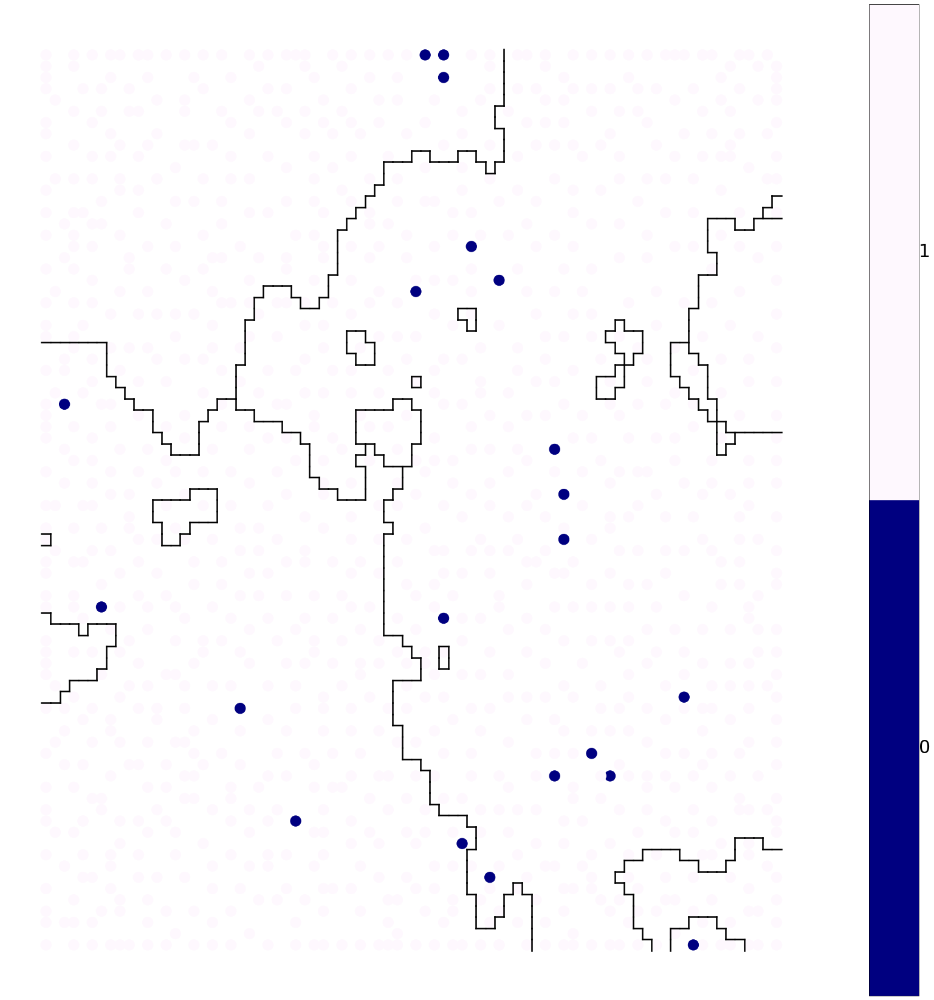

In [131]:
clusteringmap_category(sm,4,data,"n5aRing_Categ=4",'./Images/descriptors/Mw_HOMO/n5aRing45.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=5",'./Images/descriptors/Mw_HOMO/n5aRing67.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=6",'./Images/descriptors/Mw_HOMO/n5aRing89.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=7",'./Images/descriptors/Mw_HOMO/n5aRing89.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=8",'./Images/descriptors/Mw_HOMO/n5aRing89.png')
clusteringmap_category(sm,4,data,"n5aRing_Categ=9",'./Images/descriptors/Mw_HOMO/n5aRing89.png')